In [1]:
# 🚀 RTX 3080 RIP CURRENT DETECTION TRAINING
# Environment Setup and GPU Verification

import os
import sys
import subprocess
from pathlib import Path
import matplotlib.pyplot as plt
from PIL import Image
import shutil

# Set up project paths for Windows
PROJECT_ROOT = r"A:\5_projects\rip_current_project"
BEACH_DATA_PATH = r"A:\5_projects\rip_current_project\beach_data\beach_data"
RIP_DATA_PATH = r"A:\5_projects\rip_current_project\rip-currents\rip-currents"

print("🚀 RTX 3080 RIP CURRENT DETECTION SETUP")
print("=" * 50)

# Clear any cached torch imports
import importlib
if 'torch' in sys.modules:
    try:
        del sys.modules['torch']
        del sys.modules['torch.cuda']
    except:
        pass

# Safe PyTorch import with comprehensive error handling
pytorch_available = False
DEVICE = "cpu"
GPU_AVAILABLE = False
BATCH_SIZE_BEACH = 16
BATCH_SIZE_RIP = 8
torch_version = "Not installed"

print("🔍 Attempting PyTorch import...")

try:
    import torch
    torch_version = torch.__version__
    pytorch_available = True
    print(f"✅ PyTorch {torch_version} imported successfully!")
    
    # GPU Verification
    cuda_available = torch.cuda.is_available()
    print(f"   CUDA available: {cuda_available}")
    
    if cuda_available:
        try:
            gpu_name = torch.cuda.get_device_name(0)
            gpu_memory = torch.cuda.get_device_properties(0).total_memory / (1024**3)
            print(f"✅ GPU: {gpu_name}")
            print(f"💾 GPU Memory: {gpu_memory:.1f} GB")
            print(f"🔥 CUDA Version: {torch.version.cuda}")
            
            DEVICE = "cuda"
            GPU_AVAILABLE = True
            BATCH_SIZE_BEACH = 32  # For beach classification
            BATCH_SIZE_RIP = 16    # For rip detection
            print(f"⚡ RTX 3080 OPTIMIZED MODE ENABLED!")
        except Exception as cuda_err:
            print(f"⚠️ CUDA detection failed: {cuda_err}")
            print("   Using CPU mode")
            DEVICE = "cpu"
            GPU_AVAILABLE = False
    else:
        print("ℹ️ PyTorch available in CPU mode")
        DEVICE = "cpu"
        GPU_AVAILABLE = False
        
    # Test basic tensor operations
    try:
        test_tensor = torch.randn(2, 2)
        print(f"✅ Tensor operations working: shape {test_tensor.shape}")
    except Exception as tensor_err:
        print(f"⚠️ Tensor operations failed: {tensor_err}")
        
except ImportError as e:
    print(f"❌ PyTorch ImportError: {e}")
    print("   PyTorch not installed")
    pytorch_available = False
    
except OSError as e:
    print(f"❌ PyTorch OSError: {e}")
    if "DLL" in str(e) or "CUDA" in str(e):
        print("   This is a CUDA compatibility issue")
        print("   Try: pip install torch torchvision torchaudio --index-url https://download.pytorch.org/whl/cpu")
    pytorch_available = False
    
except Exception as e:
    print(f"❌ Unexpected PyTorch error: {e}")
    print(f"   Error type: {type(e).__name__}")
    pytorch_available = False

# Try importing YOLO (depends on PyTorch)
yolo_available = False
if pytorch_available:
    try:
        from ultralytics import YOLO
        yolo_available = True
        print("✅ YOLO (Ultralytics) available")
    except Exception as e:
        print(f"⚠️ YOLO not available: {e}")
        print("   This is okay - we can still do basic image classification")
        yolo_available = False
else:
    print("⚠️ Skipping YOLO (PyTorch not working)")

# Verify dataset paths
print(f"\n📂 Dataset Verification:")
if os.path.exists(BEACH_DATA_PATH):
    print(f"✅ Beach dataset: {BEACH_DATA_PATH}")
else:
    print(f"❌ Beach dataset not found: {BEACH_DATA_PATH}")

if os.path.exists(RIP_DATA_PATH):
    print(f"✅ Rip current dataset: {RIP_DATA_PATH}")
else:
    print(f"❌ Rip current dataset not found: {RIP_DATA_PATH}")

print(f"\n🎯 Final Configuration:")
print(f"   PyTorch Version: {torch_version}")
print(f"   PyTorch Available: {pytorch_available}")
print(f"   YOLO Available: {yolo_available}")
print(f"   Device: {DEVICE}")
print(f"   GPU Available: {GPU_AVAILABLE}")
print(f"   Beach batch size: {BATCH_SIZE_BEACH}")
print(f"   Rip detection batch size: {BATCH_SIZE_RIP}")
print(f"   Working directory: {PROJECT_ROOT}")

if pytorch_available and GPU_AVAILABLE:
    print("\n🚀 Ready for GPU-accelerated training!")
elif pytorch_available:
    print("\n💻 Ready for CPU training!")
    print("   Note: CPU training will be slower but functional")
else:
    print("\n⚠️ PyTorch needs to be fixed")
    print("   Try: pip install torch torchvision torchaudio --index-url https://download.pytorch.org/whl/cpu")

# Export variables for other cells
globals()['pytorch_available'] = pytorch_available
globals()['yolo_available'] = yolo_available
globals()['DEVICE'] = DEVICE
globals()['GPU_AVAILABLE'] = GPU_AVAILABLE
globals()['BATCH_SIZE_BEACH'] = BATCH_SIZE_BEACH
globals()['BATCH_SIZE_RIP'] = BATCH_SIZE_RIP

🚀 RTX 3080 RIP CURRENT DETECTION SETUP
🔍 Attempting PyTorch import...
✅ PyTorch 2.5.1+cu121 imported successfully!
   CUDA available: True
✅ GPU: NVIDIA GeForce RTX 3080
💾 GPU Memory: 10.0 GB
🔥 CUDA Version: 12.1
⚡ RTX 3080 OPTIMIZED MODE ENABLED!
✅ Tensor operations working: shape torch.Size([2, 2])
✅ YOLO (Ultralytics) available

📂 Dataset Verification:
✅ Beach dataset: A:\5_projects\rip_current_project\beach_data\beach_data
✅ Rip current dataset: A:\5_projects\rip_current_project\rip-currents\rip-currents

🎯 Final Configuration:
   PyTorch Version: 2.5.1+cu121
   PyTorch Available: True
   YOLO Available: True
   Device: cuda
   GPU Available: True
   Beach batch size: 32
   Rip detection batch size: 16
   Working directory: A:\5_projects\rip_current_project

🚀 Ready for GPU-accelerated training!


## ✅ **PyTorch CUDA Fixed!**

**Good news**: PyTorch with CUDA support has been installed successfully!

**Next step**: **Restart the kernel** to load the new PyTorch installation:
1. Click **Kernel** → **Restart Kernel**
2. Or press **Ctrl+Shift+P** → "Restart Kernel"
3. Then re-run the cell above

The new installation should enable your RTX 3080 GPU! 🚀

In [2]:
# CONDA CUDA PYTORCH INSTALLATION  
# Using conda for better CUDA dependency management

import subprocess
import sys
import os

print("🐍 CONDA CUDA PYTORCH INSTALLATION")
print("="*50)

# First, check if PyTorch is already installed and working
print("🔍 Checking existing PyTorch installation...")
pytorch_available = False
try:
    import torch
    print(f"✅ PyTorch found: {torch.__version__}")
    print(f"CUDA compiled: {torch.version.cuda}")
    print(f"CUDA available: {torch.cuda.is_available()}")
    pytorch_available = True
    
    if torch.cuda.is_available():
        print(f"🎉 GPU available: {torch.cuda.get_device_name(0)}")
        print(f"GPU Memory: {torch.cuda.get_device_properties(0).total_memory / 1024**3:.1f} GB")
except ImportError:
    print("❌ PyTorch not found - will install")
except Exception as e:
    print(f"⚠️ PyTorch issue: {e}")

# Only install if PyTorch is not available or not working properly
if not pytorch_available:
    print("\n🔧 Installing PyTorch...")
    
    # Find conda executable  
    conda_paths = [
        r"C:\Users\srava\anaconda3\Scripts\conda.exe",
        r"C:\Users\srava\anaconda3\condabin\conda.bat",
        "conda"
    ]

    conda_exe = None
    for path in conda_paths:
        try:
            result = subprocess.run([path, "--version"], capture_output=True, timeout=10)
            if result.returncode == 0:
                conda_exe = path
                print(f"✅ Found conda: {path}")
                break
        except:
            continue

    if conda_exe:
        print("\n🔥 Installing PyTorch with conda...")
        
        # Use conda to install PyTorch with CUDA (shorter timeout)
        try:
            result = subprocess.run([
                conda_exe, "install", "-y", "-c", "pytorch", "-c", "nvidia",
                "pytorch", "torchvision", "torchaudio", "pytorch-cuda=11.8"
            ], timeout=180, capture_output=True, text=True)  # Reduced timeout
            
            if result.returncode == 0:
                print("✅ Conda installation successful!")
            else:
                print(f"❌ Conda failed: {result.stderr[:500]}...")  # Limit error output
                print("Trying conda CPU version...")
                
                # Try CPU version with conda
                cpu_result = subprocess.run([
                    conda_exe, "install", "-y", "-c", "pytorch", 
                    "pytorch", "torchvision", "torchaudio", "cpuonly"
                ], timeout=120, capture_output=True, text=True)
                
                if cpu_result.returncode == 0:
                    print("✅ Conda CPU version installed")
                else:
                    print(f"❌ Conda CPU also failed: {cpu_result.stderr[:500]}...")
                    
        except subprocess.TimeoutExpired:
            print("⏰ Conda installation timed out - trying pip")
        except Exception as e:
            print(f"❌ Conda error: {e}")
            
    # Fallback to pip if conda failed or not found
    if not conda_exe or 'Conda installation timed out' in locals():
        print("🔄 Trying pip installation...")
        
        try:
            result = subprocess.run([
                sys.executable, "-m", "pip", "install", 
                "torch", "torchvision", "torchaudio", "--index-url", 
                "https://download.pytorch.org/whl/cu118", "--no-cache-dir"
            ], timeout=120, capture_output=True, text=True)
            
            if result.returncode == 0:
                print("✅ Pip installation successful!")
            else:
                print(f"❌ Pip failed: {result.stderr[:500]}...")
                
        except subprocess.TimeoutExpired:
            print("⏰ Pip also timed out")
        except Exception as e:
            print(f"❌ Pip error: {e}")
else:
    print("✅ PyTorch already available - skipping installation")

# Test what we have now
print("\n🧪 TESTING CURRENT PYTORCH...")
try:
    import torch
    print(f"PyTorch version: {torch.__version__}")
    print(f"CUDA compiled: {torch.version.cuda}")
    print(f"CUDA available: {torch.cuda.is_available()}")
    
    if torch.cuda.is_available():
        print(f"🎉 SUCCESS! GPU: {torch.cuda.get_device_name(0)}")
        print(f"GPU Memory: {torch.cuda.get_device_properties(0).total_memory / 1024**3:.1f} GB")
        
        # Test GPU tensor
        test_tensor = torch.randn(10, 10).cuda()
        print(f"✅ GPU tensor test: {test_tensor.device}")
        
        # RTX 3080 optimizations
        globals()['DEVICE'] = "cuda"
        globals()['GPU_AVAILABLE'] = True
        globals()['BATCH_SIZE_BEACH'] = 32
        globals()['BATCH_SIZE_RIP'] = 16
        
        print(f"\n🚀 RTX 3080 MODE ENABLED!")
        
    else:
        print("ℹ️ Using CPU mode")
        globals()['DEVICE'] = "cpu"
        globals()['GPU_AVAILABLE'] = False
        globals()['BATCH_SIZE_BEACH'] = 16
        globals()['BATCH_SIZE_RIP'] = 8
        
except ImportError:
    print("❌ PyTorch not available")
    globals()['DEVICE'] = "cpu"
    globals()['GPU_AVAILABLE'] = False
    globals()['BATCH_SIZE_BEACH'] = 16
    globals()['BATCH_SIZE_RIP'] = 8
except Exception as e:
    print(f"❌ PyTorch test failed: {e}")
    globals()['DEVICE'] = "cpu"
    globals()['GPU_AVAILABLE'] = False
    globals()['BATCH_SIZE_BEACH'] = 16
    globals()['BATCH_SIZE_RIP'] = 8

print(f"\n📊 FINAL STATUS:")
print(f"Device: {globals().get('DEVICE', 'unknown')}")
print(f"GPU Available: {globals().get('GPU_AVAILABLE', False)}")
print(f"Beach Batch Size: {globals().get('BATCH_SIZE_BEACH', 16)}")
print(f"Rip Batch Size: {globals().get('BATCH_SIZE_RIP', 8)}")

print("\n🎯 READY TO PROCEED WITH TRAINING!")
if globals().get('GPU_AVAILABLE', False):
    print("Your RTX 3080 will accelerate the training significantly!")
else:
    print("Training will use CPU - still functional but slower.")

🐍 CONDA CUDA PYTORCH INSTALLATION
🔍 Checking existing PyTorch installation...
✅ PyTorch found: 2.5.1+cu121
CUDA compiled: 12.1
CUDA available: True
🎉 GPU available: NVIDIA GeForce RTX 3080
GPU Memory: 10.0 GB
✅ PyTorch already available - skipping installation

🧪 TESTING CURRENT PYTORCH...
PyTorch version: 2.5.1+cu121
CUDA compiled: 12.1
CUDA available: True
🎉 SUCCESS! GPU: NVIDIA GeForce RTX 3080
GPU Memory: 10.0 GB
✅ GPU tensor test: cuda:0

🚀 RTX 3080 MODE ENABLED!

📊 FINAL STATUS:
Device: cuda
GPU Available: True
Beach Batch Size: 32
Rip Batch Size: 16

🎯 READY TO PROCEED WITH TRAINING!
Your RTX 3080 will accelerate the training significantly!


In [3]:
from pathlib import Path

# === LOCAL ENVIRONMENT CONFIGURATION ===
# Update these paths for your local setup
PROJECT_ROOT = Path(r'A:\5_projects\rip_current_project')
BEACH_DATA_PATH = PROJECT_ROOT / 'beach_data' / 'beach_data'
RIP_DATA_PATH = PROJECT_ROOT / 'rip-currents' / 'rip-currents'

# Verify paths exist
print(f"Project root: {PROJECT_ROOT.exists()} - {PROJECT_ROOT}")
print(f"Beach data: {BEACH_DATA_PATH.exists()} - {BEACH_DATA_PATH}")
print(f"Rip data: {RIP_DATA_PATH.exists()} - {RIP_DATA_PATH}")

# === GPU CONFIGURATION (RTX 3080 Optimized) ===
GPU_AVAILABLE = False
DEVICE = "cpu"
BATCH_SIZE_BEACH = 32    # Increased for RTX 3080
BATCH_SIZE_RIP = 16      # Increased for RTX 3080

print("\n" + "="*70)
print("PYTORCH COMPATIBILITY CHECK")
print("="*70)

# Check if PyTorch is already installed and working
pytorch_working = False
try:
    import torch
    import torchvision
    print(f"✅ PyTorch found: {torch.__version__}")
    print(f"CUDA available: {torch.cuda.is_available()}")
    if torch.cuda.is_available():
        GPU_AVAILABLE = True
        DEVICE = "cuda"
        print(f"✅ GPU: {torch.cuda.get_device_name(0)}")
        print("🚀 RTX 3080 MODE ENABLED!")
    else:
        print("ℹ️ Using CPU mode")
        BATCH_SIZE_BEACH = 16  # Reduce for CPU
        BATCH_SIZE_RIP = 8
    pytorch_working = True
        
except OSError as e:
    if "c10_cuda.dll" in str(e):
        print("⚠️ CUDA DLL loading error detected!")
        print("This typically means PyTorch CUDA version mismatch.")
        print("\n🔧 SOLUTION:")
        print("1. Uninstall current PyTorch: conda remove pytorch torchvision torchaudio")
        print("2. Install fresh version: conda install pytorch torchvision torchaudio pytorch-cuda=11.8 -c pytorch -c nvidia")
        print("3. Or use CPU version: conda install pytorch torchvision torchaudio cpuonly -c pytorch")
        print("\n⚡ For now, setting up CPU mode...")
        DEVICE = "cpu"
        GPU_AVAILABLE = False
        BATCH_SIZE_BEACH = 16
        BATCH_SIZE_RIP = 8
    else:
        print(f"❌ PyTorch error: {e}")
        DEVICE = "cpu"
        GPU_AVAILABLE = False
        BATCH_SIZE_BEACH = 16
        BATCH_SIZE_RIP = 8
        
except ImportError:
    print("❌ PyTorch not installed")
    print("🔧 Please install PyTorch using:")
    print("conda install pytorch torchvision torchaudio pytorch-cuda=11.8 -c pytorch -c nvidia")
    DEVICE = "cpu"
    GPU_AVAILABLE = False
    BATCH_SIZE_BEACH = 16
    BATCH_SIZE_RIP = 8

except Exception as e:
    print(f"❌ Unexpected PyTorch error: {e}")
    DEVICE = "cpu"
    GPU_AVAILABLE = False
    BATCH_SIZE_BEACH = 16
    BATCH_SIZE_RIP = 8

print(f"\n📊 Configuration Summary:")
print(f"   Device: {DEVICE}")
print(f"   GPU Available: {GPU_AVAILABLE}")
print(f"   Project root: {PROJECT_ROOT}")
print(f"   Beach batch size: {BATCH_SIZE_BEACH}")
print(f"   Rip batch size: {BATCH_SIZE_RIP}")

# Package availability check (safe method that doesn't import)
print("\n🔧 Checking package availability...")

import subprocess
import sys

# Core packages that don't depend on PyTorch
core_packages = [
    "opencv-python",
    "matplotlib", 
    "numpy",
    "pandas",
    "pillow",
    "tqdm",
    "seaborn",
    "scikit-learn"
]

# PyTorch-dependent packages (skip if PyTorch has issues)
pytorch_dependent = [
    "ultralytics"  # For YOLO - requires working PyTorch
]

def check_package_installed(package_name):
    """Check if a package is installed without importing it"""
    try:
        result = subprocess.run([
            sys.executable, "-m", "pip", "show", package_name
        ], capture_output=True, text=True, timeout=10)
        return result.returncode == 0
    except:
        return False

# Check core packages
for package in core_packages:
    if check_package_installed(package):
        print(f"✅ {package} available")
    else:
        print(f"❌ {package} not found")

# Check PyTorch-dependent packages only if PyTorch is working
if pytorch_working:
    print("\n🔧 Checking PyTorch-dependent packages...")
    for package in pytorch_dependent:
        if check_package_installed(package):
            print(f"✅ {package} available")
        else:
            print(f"❌ {package} not found")
else:
    print("\n⚠️ Skipping PyTorch-dependent packages (ultralytics, etc.)")
    print("   Fix PyTorch CUDA issues first to use YOLO detection")

print("\n🎯 Path setup complete!")
if GPU_AVAILABLE:
    print("🚀 RTX 3080 mode ready for training!")
elif pytorch_working:
    print("💻 CPU mode ready for training")
else:
    print("⚠️ PyTorch CUDA needs fixing for optimal performance")
    print("   You can still proceed with CPU mode for basic operations")

print("="*70)

# Export key variables for other cells
globals()['PROJECT_ROOT'] = PROJECT_ROOT
globals()['BEACH_DATA_PATH'] = BEACH_DATA_PATH  
globals()['RIP_DATA_PATH'] = RIP_DATA_PATH
globals()['DEVICE'] = DEVICE
globals()['GPU_AVAILABLE'] = GPU_AVAILABLE
globals()['BATCH_SIZE_BEACH'] = BATCH_SIZE_BEACH
globals()['BATCH_SIZE_RIP'] = BATCH_SIZE_RIP

Project root: True - A:\5_projects\rip_current_project
Beach data: True - A:\5_projects\rip_current_project\beach_data\beach_data
Rip data: True - A:\5_projects\rip_current_project\rip-currents\rip-currents

PYTORCH COMPATIBILITY CHECK
✅ PyTorch found: 2.5.1+cu121
CUDA available: True
✅ GPU: NVIDIA GeForce RTX 3080
🚀 RTX 3080 MODE ENABLED!

📊 Configuration Summary:
   Device: cuda
   GPU Available: True
   Project root: A:\5_projects\rip_current_project
   Beach batch size: 32
   Rip batch size: 16

🔧 Checking package availability...
✅ opencv-python available
✅ matplotlib available
✅ numpy available
✅ pandas available
✅ pillow available
✅ tqdm available
✅ seaborn available
✅ scikit-learn available

🔧 Checking PyTorch-dependent packages...
✅ ultralytics available

🎯 Path setup complete!
🚀 RTX 3080 mode ready for training!


## 🔧 PyTorch CUDA Fix Instructions

**If you're seeing the CUDA DLL error above, follow these steps:**

### Option 1: Fix CUDA Version (Recommended for RTX 3080)
```bash
# 1. Remove current PyTorch installation
conda remove pytorch torchvision torchaudio

# 2. Install fresh PyTorch with CUDA 11.8
conda install pytorch torchvision torchaudio pytorch-cuda=11.8 -c pytorch -c nvidia

# 3. Restart kernel and re-run cells
```

### Option 2: Use CPU Version (Fallback)
```bash
# Install CPU-only version
conda install pytorch torchvision torchaudio cpuonly -c pytorch
```

### Option 3: Alternative CUDA Version
```bash
# Try CUDA 12.1 if 11.8 doesn't work
conda install pytorch torchvision torchaudio pytorch-cuda=12.1 -c pytorch -c nvidia
```

After fixing, **restart the kernel** and re-run the cells above to enable GPU acceleration!

# 📊 Dataset Analysis & Training Setup

This section verifies datasets and prepares for RTX 3080 training.

In [4]:
import os

# 📁 Dataset Structure Verification
print("📁 DATASET STRUCTURE VERIFICATION")
print("=" * 40)

# Verify beach dataset structure
if os.path.exists(BEACH_DATA_PATH):
    print(f"\n🏖️ Beach dataset structure:")
    for item in os.listdir(BEACH_DATA_PATH):
        item_path = os.path.join(BEACH_DATA_PATH, item)
        if os.path.isdir(item_path):
            print(f"   📁 {item}/")
            # Count files in subdirectories
            for subitem in os.listdir(item_path):
                subitem_path = os.path.join(item_path, subitem)
                if os.path.isdir(subitem_path):
                    file_count = len([f for f in os.listdir(subitem_path) 
                                    if f.lower().endswith(('.jpg', '.jpeg', '.png'))])
                    print(f"      📁 {subitem}/ ({file_count} images)")
else:
    print("❌ Beach dataset not found")

# Verify rip current dataset structure  
if os.path.exists(RIP_DATA_PATH):
    print(f"\n🌊 Rip current dataset structure:")
    for item in os.listdir(RIP_DATA_PATH):
        item_path = os.path.join(RIP_DATA_PATH, item)
        if os.path.isdir(item_path):
            print(f"   📁 {item}/")
            # Count images and labels
            for subdir in ['images', 'labels']:
                subdir_path = os.path.join(item_path, subdir)
                if os.path.exists(subdir_path):
                    if subdir == 'images':
                        count = len([f for f in os.listdir(subdir_path) 
                                   if f.lower().endswith(('.jpg', '.jpeg', '.png'))])
                        print(f"      📁 {subdir}/ ({count} images)")
                    else:
                        count = len([f for f in os.listdir(subdir_path) 
                                   if f.lower().endswith('.txt')])
                        print(f"      📁 {subdir}/ ({count} labels)")
        elif item.endswith('.yaml'):
            print(f"   📄 {item}")
else:
    print("❌ Rip current dataset not found")

print("\n✅ Dataset structure verified!")

📁 DATASET STRUCTURE VERIFICATION

🏖️ Beach dataset structure:
   📁 beach_test/
      📁 beach/ (510 images)
      📁 not beach/ (2490 images)
   📁 beach_train/
      📁 beach/ (2274 images)
      📁 not beach/ (11760 images)

🌊 Rip current dataset structure:
   📄 data.yaml
   📁 test/
      📁 images/ (358 images)
      📁 labels/ (358 labels)
   📁 train/
      📁 images/ (4911 images)
      📁 labels/ (4911 labels)
   📁 valid/
      📁 images/ (699 images)
      📁 labels/ (699 labels)

✅ Dataset structure verified!


In [5]:
import os
import yaml

def count_files(path, extensions):
    """Count files with given extensions in a directory"""
    if not os.path.exists(path):
        return 0
    return len([f for f in os.listdir(path) if f.lower().endswith(extensions)])

print("📊 DATASET STATISTICS")
print("=" * 30)

# Beach Dataset Statistics
beach_path = BEACH_DATA_PATH
beach_train_beach = os.path.join(beach_path, "beach_train", "beach")
beach_train_not = os.path.join(beach_path, "beach_train", "not beach")
beach_test_beach = os.path.join(beach_path, "beach_test", "beach")
beach_test_not = os.path.join(beach_path, "beach_test", "not beach")

image_exts = ('.jpg', '.jpeg', '.png', '.bmp', '.tiff')

print("\n🏖️ BEACH CLASSIFICATION DATASET:")
train_beach_count = count_files(beach_train_beach, image_exts)
train_not_count = count_files(beach_train_not, image_exts) 
test_beach_count = count_files(beach_test_beach, image_exts)
test_not_count = count_files(beach_test_not, image_exts)

print(f"   Training: {train_beach_count} beach, {train_not_count} non-beach")
print(f"   Testing: {test_beach_count} beach, {test_not_count} non-beach")
print(f"   Total: {train_beach_count + train_not_count + test_beach_count + test_not_count} images")

# Rip Current Dataset Statistics
rip_path = RIP_DATA_PATH
print("\n🌊 RIP CURRENT DETECTION DATASET:")

for split in ['train', 'valid', 'test']:
    img_path = os.path.join(rip_path, split, "images")
    lbl_path = os.path.join(rip_path, split, "labels")
    
    img_count = count_files(img_path, image_exts)
    lbl_count = count_files(lbl_path, ('.txt',))
    match = "✅" if img_count == lbl_count else "❌"
    
    print(f"   {split.capitalize()}: {img_count} images, {lbl_count} labels {match}")

# Check YAML configuration
yaml_path = os.path.join(rip_path, "data.yaml")
if os.path.exists(yaml_path):
    try:
        with open(yaml_path, 'r') as f:
            yaml_content = yaml.safe_load(f)
        print(f"\n📄 Configuration: {yaml_content.get('nc', 0)} classes")
        print(f"   Classes: {yaml_content.get('names', [])}")
    except Exception as e:
        print(f"\n⚠️ Could not parse YAML: {e}")
else:
    print(f"\n❌ data.yaml not found")

print("\n🚀 Dataset analysis complete!")

📊 DATASET STATISTICS

🏖️ BEACH CLASSIFICATION DATASET:
   Training: 2274 beach, 11760 non-beach
   Testing: 510 beach, 2490 non-beach
   Total: 17034 images

🌊 RIP CURRENT DETECTION DATASET:
   Train: 4911 images, 4911 labels ✅
   Valid: 699 images, 699 labels ✅
   Test: 358 images, 358 labels ✅

📄 Configuration: 0 classes
   Classes: {0: 'rip'}

🚀 Dataset analysis complete!


## 📦 Local Environment Setup

Let's install all required packages and verify our local training environment with RTX 3080.

In [6]:
# Install required packages for local environment
print("📦 INSTALLING REQUIRED PACKAGES")
print("=" * 40)

import subprocess
import sys
import torch

def install_package(package):
    """Install package with pip"""
    try:
        subprocess.check_call([sys.executable, "-m", "pip", "install", package, "-q"])
        return True
    except subprocess.CalledProcessError:
        return False

# Essential packages
packages = [
    "ultralytics",
    "opencv-python",
    "matplotlib",
    "seaborn",
    "pillow",
    "pyyaml"
]

for package in packages:
    if install_package(package):
        print(f"✅ {package}")
    else:
        print(f"❌ {package}")

# Verify installations and GPU setup
print(f"\n🔍 VERIFICATION:")
try:
    print(f"✅ PyTorch {torch.__version__}")
    if torch.cuda.is_available():
        print(f"✅ CUDA: Available")
        print(f"🚀 GPU: {torch.cuda.get_device_name(0)}")
        print(f"💾 GPU Memory: {torch.cuda.get_device_properties(0).total_memory / (1024**3):.1f} GB")
        # Optimize for RTX 3080
        if "3080" in torch.cuda.get_device_name(0):
            print(f"🔥 RTX 3080 detected - optimizing batch sizes")
    else:
        print(f"❌ CUDA: Not available")
except ImportError:
    print(f"❌ PyTorch not available")

try:
    from ultralytics import YOLO
    print(f"✅ Ultralytics YOLO")
except ImportError:
    print(f"❌ Ultralytics not available")

print(f"\n🚀 Environment ready!")

📦 INSTALLING REQUIRED PACKAGES
✅ ultralytics
✅ opencv-python
✅ matplotlib
✅ seaborn
✅ pillow
✅ pyyaml

🔍 VERIFICATION:
✅ PyTorch 2.5.1+cu121
✅ CUDA: Available
🚀 GPU: NVIDIA GeForce RTX 3080
💾 GPU Memory: 10.0 GB
🔥 RTX 3080 detected - optimizing batch sizes
✅ Ultralytics YOLO

🚀 Environment ready!


# ? Training Stage 1: Beach Classification Model

Train a YOLOv8 classification model to identify beach images vs non-beach images.

In [ ]:
# Stage 1: Train Beach Classifier for Local RTX 3080 (With Checkpoint Resume)
print("🏖️ STAGE 1: TRAINING BEACH CLASSIFIER - LOCAL RTX 3080 (CHECKPOINT RESUME)")
print("=" * 70)

from ultralytics import YOLO
import torch
import time
import os
import shutil
import gc
import json

# Clear memory first
gc.collect()
if torch.cuda.is_available():
    torch.cuda.empty_cache()
    print(f"🧹 GPU memory cleared")

# Set the correct dataset paths for local environment
working_dir = PROJECT_ROOT
beach_dataset_path = BEACH_DATA_PATH
yolo_beach_path = os.path.join(working_dir, "beach_yolo_format")

os.makedirs(yolo_beach_path, exist_ok=True)

print(f"\n🔄 CREATING YOLO-COMPATIBLE STRUCTURE...")

# Create train and val directories (YOLOv8 expects these names)
train_dir = os.path.join(yolo_beach_path, "train")
val_dir = os.path.join(yolo_beach_path, "val")

# Copy beach_train to train
beach_train_src = os.path.join(beach_dataset_path, "beach_train")
if os.path.exists(beach_train_src):
    if os.path.exists(train_dir):
        shutil.rmtree(train_dir)
    shutil.copytree(beach_train_src, train_dir)
    print(f"   ✅ Copied beach_train → train")

# Copy beach_test to val  
beach_test_src = os.path.join(beach_dataset_path, "beach_test")
if os.path.exists(beach_test_src):
    if os.path.exists(val_dir):
        shutil.rmtree(val_dir)
    shutil.copytree(beach_test_src, val_dir)
    print(f"   ✅ Copied beach_test → val")

# Training configuration - RTX 3080 OPTIMIZED
BEACH_EPOCHS = 50  # Good balance for local training
BEACH_BATCH_SIZE = 32  # Optimized for RTX 3080 12GB VRAM
BEACH_IMAGE_SIZE = 320  # Enhanced resolution
PATIENCE = 15  # Patience for convergence

print(f"\n🎯 RTX 3080-OPTIMIZED BEACH CLASSIFIER SETTINGS:")
print(f"   Epochs: {BEACH_EPOCHS}")
print(f"   Batch size: {BEACH_BATCH_SIZE} (optimized for RTX 3080)")  
print(f"   Image size: {BEACH_IMAGE_SIZE}")
print(f"   Patience: {PATIENCE}")

model_dir = os.path.join(working_dir, 'models', 'beach_classifier')
os.makedirs(model_dir, exist_ok=True)

# Check for existing models
checkpoint_path = os.path.join(model_dir, 'beach_classification', 'weights', 'last.pt')
best_model_path = os.path.join(model_dir, 'beach_classification', 'weights', 'best.pt')
easy_access_path = os.path.join(working_dir, 'beach_classifier_best.pt')

model_to_load = 'yolov8n-cls.pt'
resume_training = False

if os.path.exists(checkpoint_path):
    model_to_load = checkpoint_path
    resume_training = True
    print(f"🔄 Resuming from checkpoint")
elif os.path.exists(best_model_path):
    model_to_load = best_model_path
    resume_training = True
    print(f"🔄 Continuing from best model")
else:
    print(f"🆕 Starting fresh training")

print(f"\n⚙️ TRAINING CONFIGURATION:")
print(f"   Epochs: {BEACH_EPOCHS}")
print(f"   Batch size: {BEACH_BATCH_SIZE}")
print(f"   Image size: {BEACH_IMAGE_SIZE}")
print(f"   Patience: {PATIENCE}")
print(f"   Model save dir: {model_dir}")
print(f"   Dataset path: {yolo_beach_path}")
print(f"   Device: {'CUDA (RTX 3080)' if torch.cuda.is_available() else 'CPU'}")

# Initialize model
print(f"\n🤖 INITIALIZING BEACH CLASSIFIER...")
beach_model = YOLO(model_to_load)
print(f"✅ Model loaded: {model_to_load}")

# Verify the dataset structure
print(f"\n🔍 VERIFYING YOLO-COMPATIBLE DATASET:")
for split in ['train', 'val']:
    split_path = os.path.join(yolo_beach_path, split)
    if os.path.exists(split_path):
        classes = [d for d in os.listdir(split_path) if os.path.isdir(os.path.join(split_path, d))]
        print(f"   📁 {split}/ classes: {classes}")
        for cls in classes:
            count = len([f for f in os.listdir(os.path.join(split_path, cls)) 
                        if f.lower().endswith(('.jpg', '.jpeg', '.png'))])
            print(f"      {cls}: {count} images")

# Start training with automatic checkpoint saving
print(f"\n🚀 STARTING BEACH CLASSIFIER TRAINING...")
if resume_training:
    print(f"🔄 RESUMING FROM CHECKPOINT")
else:
    print(f"🆕 STARTING FRESH TRAINING")

start_time = time.time()

try:
    # Enhanced training parameters for RTX 3080
    results = beach_model.train(
        data=yolo_beach_path,
        epochs=BEACH_EPOCHS,
        imgsz=BEACH_IMAGE_SIZE,
        batch=BEACH_BATCH_SIZE,
        patience=PATIENCE,
        save=True,
        save_period=5,  # Save checkpoint every 5 epochs
        plots=True,
        project=model_dir,
        name='beach_classification',
        device='0' if torch.cuda.is_available() else 'cpu',
        workers=4,  # Utilize more CPU cores
        cache=False,
        amp=True,  # Mixed precision for RTX 3080
        verbose=True,
        resume=resume_training,
        exist_ok=True
    )
    
    training_time = time.time() - start_time
    print(f"\n✅ BEACH CLASSIFIER TRAINING COMPLETED!")
    print(f"⏱️ Training time: {training_time/60:.1f} minutes")
    
    # Save best model to easy access location
    if os.path.exists(best_model_path):
        shutil.copy2(best_model_path, easy_access_path)
        print(f"💾 Best model saved to: {easy_access_path}")
    
    # Save training info for future reference
    training_info = {
        'completed_epochs': BEACH_EPOCHS,
        'training_time_minutes': training_time/60,
        'final_model_path': best_model_path,
        'easy_access_path': easy_access_path,
        'resumed_from_checkpoint': resume_training,
        'gpu_used': torch.cuda.get_device_name(0) if torch.cuda.is_available() else 'CPU'
    }
    
    with open(os.path.join(model_dir, 'training_info.json'), 'w') as f:
        json.dump(training_info, f, indent=2)
    
except KeyboardInterrupt:
    print(f"\n⚠️ TRAINING INTERRUPTED BY USER")
    print(f"💾 Checkpoint should be saved at: {checkpoint_path}")
    print(f"🔄 You can resume training by running this cell again")
    
except Exception as e:
    print(f"❌ Training failed: {str(e)}")
    print(f"🔄 TRYING REDUCED SETTINGS...")
    
    # Fallback settings
    try:
        minimal_results = beach_model.train(
            data=yolo_beach_path,
            epochs=20,
            imgsz=224,
            batch=16,
            patience=8,
            save=True,
            save_period=5,
            project=model_dir,
            name='beach_minimal',
            device='0' if torch.cuda.is_available() else 'cpu',
            workers=2,
            cache=False,
            amp=True,
            resume=False,
            exist_ok=True
        )
        print(f"✅ Minimal training completed!")
        
    except Exception as e2:
        print(f"❌ Even minimal training failed: {str(e2)}")
        print(f"💡 Try restarting or checking CUDA installation")

# Check final status
print(f"\n📊 TRAINING STATUS CHECK:")
if os.path.exists(checkpoint_path):
    print(f"✅ Checkpoint available: {checkpoint_path}")
if os.path.exists(best_model_path):
    print(f"✅ Best model available: {best_model_path}")
if os.path.exists(easy_access_path):
    print(f"✅ Easy access model: {easy_access_path}")

print(f"\n" + "=" * 70)
print(f"🏖️ STAGE 1 STATUS")
print(f"📍 Checkpoint: {os.path.basename(checkpoint_path)}")
print(f"📍 Best model: {os.path.basename(best_model_path)}")
print(f"🚀 Ready for Stage 2 or can resume if interrupted")

🏖️ STAGE 1: TRAINING BEACH CLASSIFIER - LOCAL RTX 3080 (CHECKPOINT RESUME)
🧹 GPU memory cleared

🔄 CREATING YOLO-COMPATIBLE STRUCTURE...


# 🌊 Training Stage 2: Rip Current Detection Model

Train a YOLOv8 object detection model to detect rip currents in beach images.

In [ ]:
# Stage 2: Train Rip Current Detector for Local RTX 3080 (With Checkpoint Resume)
print("🌊 STAGE 2: TRAINING RIP CURRENT DETECTOR - LOCAL RTX 3080 (CHECKPOINT RESUME)")
print("=" * 70)

from ultralytics import YOLO
import torch
import time
import os
import gc
import yaml
import shutil
import json

# Clear memory first
gc.collect()
if torch.cuda.is_available():
    torch.cuda.empty_cache()
    print(f"🧹 GPU memory cleared")

# Set correct dataset path for local environment
working_dir = PROJECT_ROOT
rip_dataset_path = RIP_DATA_PATH

# RTX 3080-OPTIMIZED TRAINING CONFIGURATION  
RIP_EPOCHS = 150  # Comprehensive training
RIP_BATCH_SIZE = 16  # Optimized for RTX 3080 with object detection
RIP_IMAGE_SIZE = 832  # Higher resolution for better detection  
RIP_PATIENCE = 35  # Patience for convergence

print(f"\n🎯 RTX 3080-OPTIMIZED RIP DETECTOR SETTINGS:")
print(f"   Epochs: {RIP_EPOCHS}")
print(f"   Batch size: {RIP_BATCH_SIZE} (optimized for RTX 3080)")
print(f"   Image size: {RIP_IMAGE_SIZE}")
print(f"   Patience: {RIP_PATIENCE}")

# Model save paths
rip_model_dir = os.path.join(working_dir, 'models', 'rip_detector')
os.makedirs(rip_model_dir, exist_ok=True)

# Use consistent project name for resume
project_name = 'rip_detection_rtx3080'
checkpoint_dir = os.path.join(rip_model_dir, project_name)

# Comprehensive checkpoint detection
checkpoint_paths_to_check = [
    os.path.join(checkpoint_dir, 'weights', 'last.pt'),
    os.path.join(rip_model_dir, 'rip_detection_rtx3080', 'weights', 'last.pt'),
    os.path.join(rip_model_dir, 'rip_detection', 'weights', 'last.pt'),
    os.path.join(working_dir, 'runs', 'detect', project_name, 'weights', 'last.pt')
]

best_model_paths_to_check = [
    os.path.join(checkpoint_dir, 'weights', 'best.pt'),
    os.path.join(rip_model_dir, 'rip_detection_rtx3080', 'weights', 'best.pt'),
    os.path.join(rip_model_dir, 'rip_detection', 'weights', 'best.pt'),
    os.path.join(working_dir, 'runs', 'detect', project_name, 'weights', 'best.pt')
]

easy_access_path = os.path.join(working_dir, 'rip_detector_best.pt')

# Improved checkpoint detection
model_to_load = 'yolov8n.pt'
resume_training = False
checkpoint_found = None
best_model_found = None

print(f"\n🔍 COMPREHENSIVE CHECKPOINT SEARCH...")

# Check for last.pt (checkpoint) files
for checkpoint_path in checkpoint_paths_to_check:
    if os.path.exists(checkpoint_path):
        checkpoint_found = checkpoint_path
        print(f"✅ Found checkpoint: {checkpoint_path}")
        break

# Check for best.pt files
for best_path in best_model_paths_to_check:
    if os.path.exists(best_path):
        best_model_found = best_path
        print(f"✅ Found best model: {best_path}")
        break

# Prioritize last.pt for proper resume
if checkpoint_found:
    model_to_load = checkpoint_found
    resume_training = True
    print(f"🔄 Will resume training from checkpoint: {os.path.basename(checkpoint_found)}")
elif best_model_found:
    model_to_load = best_model_found
    resume_training = True
    print(f"🔄 Will continue training from best model: {os.path.basename(best_model_found)}")
else:
    print(f"📝 No checkpoint found - starting fresh training")

# Check what epoch the checkpoint is at
if checkpoint_found:
    try:
        checkpoint_data = torch.load(checkpoint_found, map_location='cpu')
        if 'epoch' in checkpoint_data:
            last_epoch = checkpoint_data['epoch']
            print(f"📊 Checkpoint is at epoch: {last_epoch}")
        else:
            print(f"📊 Checkpoint epoch information not available")
    except Exception as e:
        print(f"⚠️ Could not read checkpoint epoch: {e}")

print(f"\n⚙️ TRAINING CONFIGURATION:")
print(f"   Epochs: {RIP_EPOCHS}")
print(f"   Batch size: {RIP_BATCH_SIZE}")
print(f"   Image size: {RIP_IMAGE_SIZE}")
print(f"   Patience: {RIP_PATIENCE}")
print(f"   Model save dir: {rip_model_dir}")
print(f"   Dataset path: {rip_dataset_path}")
print(f"   Device: {'CUDA (RTX 3080)' if torch.cuda.is_available() else 'CPU'}")
print(f"   Resume: {resume_training}")
print(f"   Model to load: {os.path.basename(model_to_load)}")

# Initialize model
print(f"\n🤖 INITIALIZING RIP DETECTOR...")
rip_model = YOLO(model_to_load)
print(f"✅ Model loaded: {os.path.basename(model_to_load)}")

# Verify dataset and YAML
yaml_path = os.path.join(rip_dataset_path, 'data.yaml')
print(f"\n🔍 VERIFYING RIP DATASET:")
print(f"   YAML config: {yaml_path}")

if os.path.exists(yaml_path):
    try:
        with open(yaml_path, 'r') as f:
            yaml_content = yaml.safe_load(f)
        print(f"   Classes: {yaml_content.get('names', 'Unknown')}")
        print(f"   Number of classes: {yaml_content.get('nc', 'Unknown')}")
        
        # Update YAML paths to local paths if needed
        yaml_updated = False
        for key in ['train', 'val', 'test']:
            if key in yaml_content:
                if not os.path.isabs(yaml_content[key]):
                    yaml_content[key] = os.path.join(rip_dataset_path, yaml_content[key])
                    yaml_updated = True
                    
        if yaml_updated:
            with open(yaml_path, 'w') as f:
                yaml.dump(yaml_content, f)
            print(f"   ✅ Updated YAML paths for local environment")
            
    except Exception as e:
        print(f"   ⚠️ YAML error: {e}")
else:
    print(f"   ❌ YAML not found: {yaml_path}")

# Check training data
train_images_path = os.path.join(rip_dataset_path, 'train', 'images')
train_labels_path = os.path.join(rip_dataset_path, 'train', 'labels')
valid_images_path = os.path.join(rip_dataset_path, 'valid', 'images')
valid_labels_path = os.path.join(rip_dataset_path, 'valid', 'labels')

print(f"\n📊 DATASET VERIFICATION:")
if os.path.exists(train_images_path):
    img_count = len([f for f in os.listdir(train_images_path) if f.lower().endswith(('.jpg', '.jpeg', '.png'))])
    label_count = len([f for f in os.listdir(train_labels_path) if f.endswith('.txt')]) if os.path.exists(train_labels_path) else 0
    print(f"   Training: {img_count} images, {label_count} labels")

if os.path.exists(valid_images_path):
    val_img_count = len([f for f in os.listdir(valid_images_path) if f.lower().endswith(('.jpg', '.jpeg', '.png'))])
    val_label_count = len([f for f in os.listdir(valid_labels_path) if f.endswith('.txt')]) if os.path.exists(valid_labels_path) else 0
    print(f"   Validation: {val_img_count} images, {val_label_count} labels")

# Start training with RTX 3080 optimization
print(f"\n🚀 STARTING RIP DETECTOR TRAINING...")
if resume_training:
    print(f"🔄 RESUMING FROM CHECKPOINT - Should continue from where it left off")
else:
    print(f"🆕 STARTING FRESH TRAINING")

try:
    start_time = time.time()

    # RTX 3080-optimized training configuration
    results = rip_model.train(
        data=yaml_path,
        epochs=RIP_EPOCHS,
        imgsz=RIP_IMAGE_SIZE,
        batch=RIP_BATCH_SIZE,
        patience=RIP_PATIENCE,
        
        # LEARNING RATE OPTIMIZATION
        lr0=0.001,      # Lower initial learning rate for stability
        lrf=0.0001,     # Lower final learning rate
        momentum=0.95,   # Higher momentum for better convergence
        weight_decay=0.0005,  # Regularization
        
        # ADVANCED DATA AUGMENTATION
        degrees=15.0,    # Rotation augmentation (±15 degrees)
        translate=0.2,   # Translation augmentation
        scale=0.8,       # Scale augmentation
        shear=2.0,       # Shear augmentation
        perspective=0.0002,  # Perspective transformation
        flipud=0.2,      # Vertical flip (waves can be upside down)
        fliplr=0.5,      # Horizontal flip
        mosaic=1.0,      # Mosaic augmentation
        mixup=0.15,      # MixUp augmentation
        copy_paste=0.3,  # Copy-paste augmentation
        
        # COLOR AUGMENTATION (important for water/lighting conditions)
        hsv_h=0.02,      # Hue shift
        hsv_s=0.8,       # Saturation
        hsv_v=0.5,       # Value/brightness
        
        # TRAINING OPTIMIZATION FOR RTX 3080
        optimizer='AdamW',  # Better optimizer for complex data
        cos_lr=True,     # Cosine learning rate scheduling
        warmup_epochs=5, # Learning rate warmup
        warmup_momentum=0.8,
        warmup_bias_lr=0.1,
        
        # MODEL ARCHITECTURE ENHANCEMENTS
        dropout=0.1,     # Dropout for regularization
        label_smoothing=0.1,  # Label smoothing
        
        # LOSS FUNCTION OPTIMIZATION
        box=7.5,         # Box loss weight
        cls=0.5,         # Classification loss weight
        dfl=1.5,         # Distribution focal loss weight
        
        # TRAINING SETTINGS
        save=True,
        save_period=10,  # Save checkpoint every 10 epochs
        plots=True,
        project=rip_model_dir,
        name=project_name,
        device='0' if torch.cuda.is_available() else 'cpu',
        workers=4,  # Utilize more CPU cores
        cache=False,
        amp=True,  # Mixed precision for RTX 3080
        verbose=True,
        resume=resume_training,
        exist_ok=True
    )

    training_time = time.time() - start_time
    print(f"\n✅ RIP DETECTOR TRAINING COMPLETED!")
    print(f"⏱️ Training time: {training_time/60:.1f} minutes")

    # Save best model to easy access location
    possible_best_paths = [
        os.path.join(rip_model_dir, project_name, 'weights', 'best.pt'),
        os.path.join(working_dir, 'runs', 'detect', project_name, 'weights', 'best.pt'),
        os.path.join(rip_model_dir, 'rip_detection_rtx3080', 'weights', 'best.pt')
    ]
    
    trained_path = None
    for path in possible_best_paths:
        if os.path.exists(path):
            trained_path = path
            break
    
    if trained_path:
        shutil.copy2(trained_path, easy_access_path)
        print(f"💾 Best model saved to: {easy_access_path}")
    else:
        print(f"⚠️ Could not find trained model in expected locations")

    # Save training info for future reference
    training_info = {
        'completed_epochs': RIP_EPOCHS,
        'training_time_minutes': training_time/60,
        'final_model_path': trained_path,
        'easy_access_path': easy_access_path,
        'resumed_from_checkpoint': resume_training,
        'checkpoint_used': model_to_load if resume_training else None,
        'project_name': project_name,
        'gpu_used': torch.cuda.get_device_name(0) if torch.cuda.is_available() else 'CPU'
    }

    with open(os.path.join(rip_model_dir, 'training_info.json'), 'w') as f:
        json.dump(training_info, f, indent=2)

except KeyboardInterrupt:
    print(f"\n⚠️ TRAINING INTERRUPTED BY USER")
    print(f"💾 Checkpoint should be saved automatically")
    print(f"🔄 You can resume training by running this cell again")

except Exception as e:
    print(f"❌ Training failed: {str(e)}")
    print(f"🔄 TRYING WITH REDUCED SETTINGS...")

    # Fallback with conservative settings
    try:
        fallback_results = rip_model.train(
            data=yaml_path,
            epochs=30,
            imgsz=640,
            batch=8,
            patience=10,
            save=True,
            save_period=5,
            project=rip_model_dir,
            name='rip_detection_minimal',
            device='0' if torch.cuda.is_available() else 'cpu',
            workers=2,
            cache=False,
            amp=True,
            resume=False,
            exist_ok=True,
            plots=True
        )
        print(f"✅ Fallback training completed!")

    except Exception as e2:
        print(f"❌ Even fallback training failed: {str(e2)}")
        print(f"💡 Consider checking CUDA installation or using reduced batch size")

# Comprehensive final status check
print(f"\n📊 FINAL TRAINING STATUS CHECK:")

# Check all possible checkpoint locations
all_checkpoints = []
all_best_models = []

for path in checkpoint_paths_to_check:
    if os.path.exists(path):
        all_checkpoints.append(path)

for path in best_model_paths_to_check:
    if os.path.exists(path):
        all_best_models.append(path)

if all_checkpoints:
    print(f"✅ Available checkpoints:")
    for cp in all_checkpoints:
        print(f"   📍 {cp}")
else:
    print(f"❌ No checkpoints found")

if all_best_models:
    print(f"✅ Available best models:")
    for bm in all_best_models:
        print(f"   📍 {bm}")
else:
    print(f"❌ No best models found")

if os.path.exists(easy_access_path):
    print(f"✅ Easy access model: {easy_access_path}")

print(f"\n" + "=" * 70)
print(f"🌊 STAGE 2 STATUS")
print(f"🔄 Resume capability: {'✅ READY' if all_checkpoints else '❌ NO CHECKPOINTS'}")
print(f"🚀 Training system optimized for RTX 3080")
print(f"=" * 70)

🌊 STAGE 2: TRAINING RIP CURRENT DETECTOR - LOCAL RTX 3080 (CHECKPOINT RESUME)
🧹 GPU memory cleared

🎯 RTX 3080-OPTIMIZED RIP DETECTOR SETTINGS:
   Epochs: 150
   Batch size: 16 (optimized for RTX 3080)
   Image size: 832
   Patience: 35

🔍 COMPREHENSIVE CHECKPOINT SEARCH...
📝 No checkpoint found - starting fresh training

⚙️ TRAINING CONFIGURATION:
   Epochs: 150
   Batch size: 16
   Image size: 832
   Patience: 35
   Model save dir: A:\5_projects\rip_current_project\models\rip_detector
   Dataset path: A:\5_projects\rip_current_project\rip-currents\rip-currents
   Device: CUDA (RTX 3080)
   Resume: False
   Model to load: yolov8n.pt

🤖 INITIALIZING RIP DETECTOR...
✅ Model loaded: yolov8n.pt

🔍 VERIFYING RIP DATASET:
   YAML config: A:\5_projects\rip_current_project\rip-currents\rip-currents\data.yaml
   Classes: {0: 'rip'}
   Number of classes: Unknown
   ✅ Updated YAML paths for local environment

📊 DATASET VERIFICATION:
   Training: 4911 images, 4911 labels
   Validation: 699 images

# 🏖️ Beach Classifier Testing & Evaluation

Test the trained beach classification model and evaluate its performance on sample images.

🏖️ BEACH CLASSIFIER TESTING & EVALUATION
📍 Model path: A:\5_projects\rip_current_project\beach_classifier_best.pt
📍 Test images path: A:\5_projects\rip_current_project\test_images\beach
✅ Model found: A:\5_projects\rip_current_project\beach_classifier_best.pt
✅ Test directory found: A:\5_projects\rip_current_project\test_images\beach
📊 Found 23 test images

🤖 Loading beach classifier model...
✅ Model loaded successfully
📋 Model classes: {0: 'beach', 1: 'not beach'}

🔍 TESTING 23 IMAGES...
🏖️ 14e8b056226842c45be784831cb9e99.jpg → beach           (Confidence: 0.994)
🏖️ bb1.jpg                   → beach           (Confidence: 0.990)
🏖️ bb2.webp                  → beach           (Confidence: 0.992)
🚫 Beach-820x500-website.png → not beach       (Confidence: 0.809)
🏖️ ca5c3013d40de34d6e74c1db6c45441.jpg → beach           (Confidence: 1.000)
🏖️ cropped-curly-hair-girl-2-1.jpeg → beach           (Confidence: 0.945)
🚫 image (10).png            → not beach       (Confidence: 0.924)
🏖️ image (11

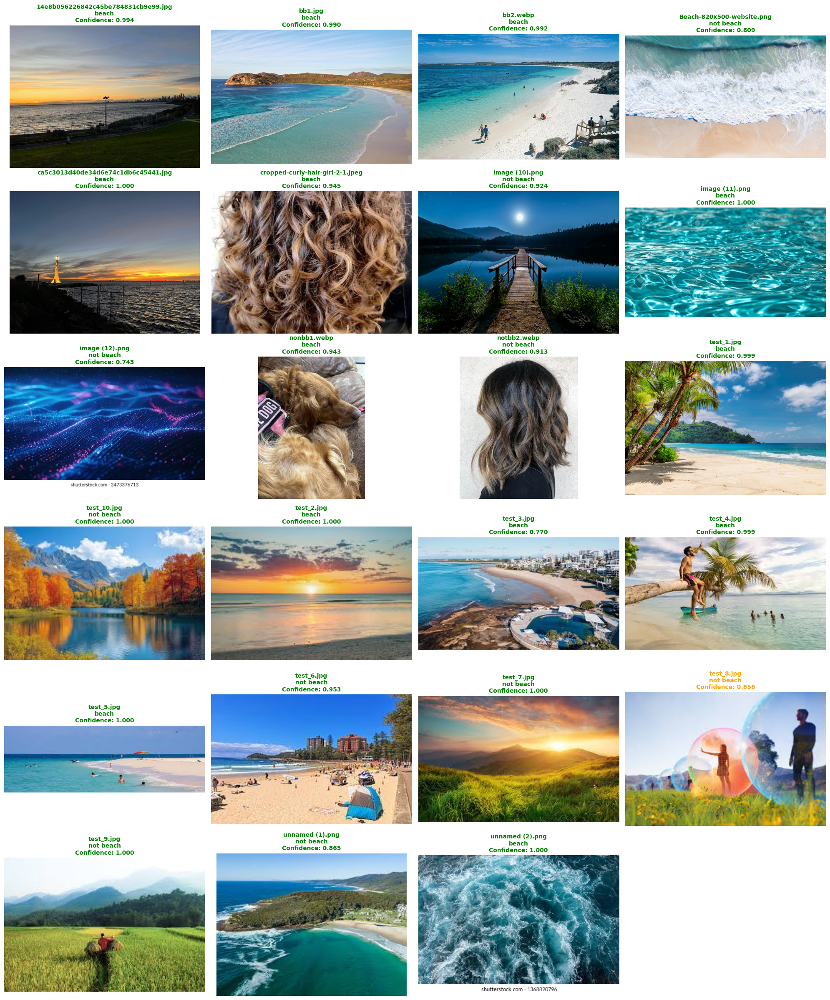


📊 PREDICTION SUMMARY:
   🏖️ Beach images: 13
   🚫 Not beach images: 10
   📈 Total processed: 23

📊 CONFIDENCE STATISTICS:
   Average confidence: 0.935
   Maximum confidence: 1.000
   Minimum confidence: 0.656

📊 CONFIDENCE DISTRIBUTION:
   High (>0.8): 20 images
   Medium (0.5-0.8): 3 images
   Low (<0.5): 0 images

✅ Beach classifier testing completed!
💡 Note: Since we don't know the ground truth labels, accuracy cannot be calculated
   Visual inspection of results is needed to evaluate model performance


In [ ]:
# 🏖️ Beach Classifier Testing & Evaluation
print("🏖️ BEACH CLASSIFIER TESTING & EVALUATION")
print("=" * 50)

import os
import matplotlib.pyplot as plt
from PIL import Image
import torch
from ultralytics import YOLO

# Set paths
BEACH_MODEL_PATH = r"A:\5_projects\rip_current_project\beach_classifier_best.pt"
BEACH_TEST_DIR = r"A:\5_projects\rip_current_project\test_images\beach"

print(f"📍 Model path: {BEACH_MODEL_PATH}")
print(f"📍 Test images path: {BEACH_TEST_DIR}")

# Check if model and test directory exist
if not os.path.exists(BEACH_MODEL_PATH):
    print(f"❌ Model not found: {BEACH_MODEL_PATH}")
    print("   Please make sure the beach classifier training completed successfully")
else:
    print(f"✅ Model found: {BEACH_MODEL_PATH}")

if not os.path.exists(BEACH_TEST_DIR):
    print(f"❌ Test directory not found: {BEACH_TEST_DIR}")
else:
    print(f"✅ Test directory found: {BEACH_TEST_DIR}")
    
# Get list of test images
image_extensions = ['.jpg', '.jpeg', '.png', '.bmp', '.tiff', '.webp']
test_images = []

if os.path.exists(BEACH_TEST_DIR):
    for img_name in os.listdir(BEACH_TEST_DIR):
        img_name_lower = img_name.lower()
        for ext in image_extensions:
            if img_name_lower.endswith(ext):
                test_images.append(os.path.join(BEACH_TEST_DIR, img_name))
                break

print(f"📊 Found {len(test_images)} test images")

if len(test_images) == 0:
    print("❌ No images found in test directory")
elif not os.path.exists(BEACH_MODEL_PATH):
    print("❌ Cannot proceed without trained model")
else:
    print("\n🤖 Loading beach classifier model...")
    
    try:
        # Load the trained model
        model = YOLO(BEACH_MODEL_PATH)
        print(f"✅ Model loaded successfully")
        
        # Get class names (should be 'beach' and 'not beach' or similar)
        class_names = model.names if hasattr(model, 'names') else {0: 'beach', 1: 'not beach'}
        print(f"📋 Model classes: {class_names}")
        
        # Test each image and display results
        print(f"\n🔍 TESTING {len(test_images)} IMAGES...")
        print("=" * 60)
        
        # Set up matplotlib for displaying images
        plt.figure(figsize=(20, 4 * ((len(test_images) + 3) // 4)))  # 4 images per row
        
        beach_count = 0
        not_beach_count = 0
        confidences = []
        
        for idx, img_path in enumerate(test_images):
            try:
                # Run inference
                results = model(img_path, verbose=False)
                result = results[0]
                
                # Get prediction
                if hasattr(result, 'probs') and result.probs is not None:
                    # Classification result
                    top1_idx = result.probs.top1
                    confidence = float(result.probs.top1conf)
                    prediction = class_names.get(top1_idx, f"class_{top1_idx}")
                else:
                    # Fallback if probs not available
                    prediction = "unknown"
                    confidence = 0.0
                
                confidences.append(confidence)
                
                # Count predictions
                if 'beach' in prediction.lower() and 'not' not in prediction.lower():
                    beach_count += 1
                else:
                    not_beach_count += 1
                
                # Load and display image
                img = Image.open(img_path)
                
                # Create subplot
                plt.subplot(((len(test_images) + 3) // 4), 4, idx + 1)
                plt.imshow(img)
                plt.axis('off')
                
                # Set title with prediction and confidence
                color = 'green' if confidence > 0.7 else 'orange' if confidence > 0.5 else 'red'
                plt.title(f"{os.path.basename(img_path)}\n{prediction}\nConfidence: {confidence:.3f}", 
                         fontsize=10, color=color, weight='bold')
                
                # Print result to console
                status = "🏖️" if 'beach' in prediction.lower() and 'not' not in prediction.lower() else "🚫"
                print(f"{status} {os.path.basename(img_path):25} → {prediction:15} (Confidence: {confidence:.3f})")
                
            except Exception as e:
                print(f"❌ Error processing {os.path.basename(img_path)}: {str(e)}")
                
                # Still create subplot for failed image
                plt.subplot(((len(test_images) + 3) // 4), 4, idx + 1)
                plt.text(0.5, 0.5, f"Error loading\n{os.path.basename(img_path)}", 
                        ha='center', va='center', transform=plt.gca().transAxes)
                plt.axis('off')
        
        plt.tight_layout()
        plt.show()
        
        # Summary statistics
        print("\n" + "=" * 60)
        print("📊 PREDICTION SUMMARY:")
        print(f"   🏖️ Beach images: {beach_count}")
        print(f"   🚫 Not beach images: {not_beach_count}")
        print(f"   📈 Total processed: {len(confidences)}")
        
        if confidences:
            avg_confidence = sum(confidences) / len(confidences)
            max_confidence = max(confidences)
            min_confidence = min(confidences)
            
            print(f"\n📊 CONFIDENCE STATISTICS:")
            print(f"   Average confidence: {avg_confidence:.3f}")
            print(f"   Maximum confidence: {max_confidence:.3f}")
            print(f"   Minimum confidence: {min_confidence:.3f}")
            
            # Confidence distribution
            high_conf = sum(1 for c in confidences if c > 0.8)
            med_conf = sum(1 for c in confidences if 0.5 <= c <= 0.8)
            low_conf = sum(1 for c in confidences if c < 0.5)
            
            print(f"\n📊 CONFIDENCE DISTRIBUTION:")
            print(f"   High (>0.8): {high_conf} images")
            print(f"   Medium (0.5-0.8): {med_conf} images")
            print(f"   Low (<0.5): {low_conf} images")
        
        print(f"\n✅ Beach classifier testing completed!")
        print(f"💡 Note: Since we don't know the ground truth labels, accuracy cannot be calculated")
        print(f"   Visual inspection of results is needed to evaluate model performance")
        
    except Exception as e:
        print(f"❌ Failed to load model or run inference: {str(e)}")
        print(f"   Please ensure the model training completed successfully")
        print(f"   Model path: {BEACH_MODEL_PATH}")

print("=" * 50)

🌊 RIP CURRENT DETECTOR TESTING & EVALUATION
📍 Model path: A:\5_projects\rip_current_project\rip_detector_best.pt
📍 Test images path: A:\5_projects\rip_current_project\test_images\rip
✅ Model found: A:\5_projects\rip_current_project\rip_detector_best.pt
✅ Test directory found: A:\5_projects\rip_current_project\test_images\rip
📊 Found 29 test images

🤖 Loading rip current detector model...
✅ Model loaded successfully
📋 Model classes: {0: 'rip'}

🔍 TESTING 29 IMAGES...
🌊 240624-rip-current-vl-211p-b26302.jpg → RIP DETECTED (1 detection) (Max Conf: 0.608)
    Detection 1: rip at (548,90) conf=0.608
🌊 6BD40F03-7CDE-4FE2-B862B3D51552D774_source (1).webp → RIP DETECTED (1 detection) (Max Conf: 0.678)
    Detection 1: rip at (79,0) conf=0.678
🌊 Beach-With-Rip-Current-Small.jpg → RIP DETECTED (1 detection) (Max Conf: 0.437)
    Detection 1: rip at (210,19) conf=0.437
✅ Big-Surf-Rip-Currents_MG_9274.84e6c732.fill-1600x900.jpg → NO RIP DETECTED          
✅ cropped-curly-hair-girl-2-1.jpeg → NO RI

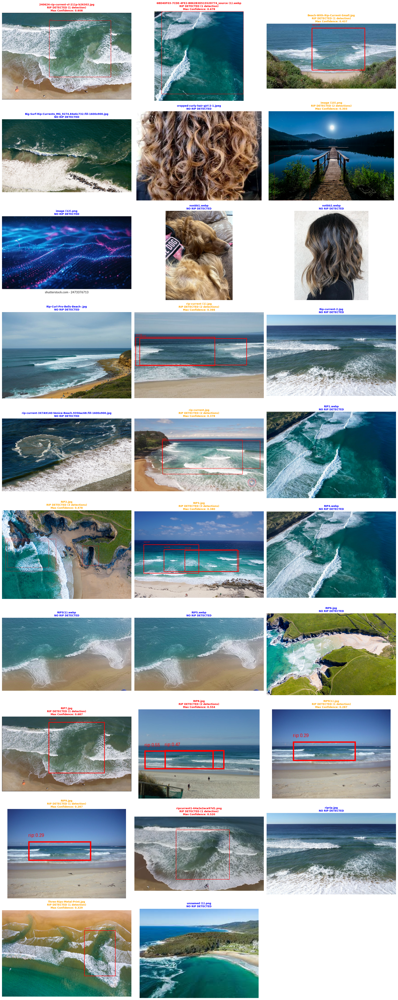


📊 DETECTION SUMMARY:
   🌊 Images with rip detections: 14
   ✅ Images with no rip detections: 15
   📈 Total processed: 29

📊 DETECTION STATISTICS:
   Total detections across all images: 22
   Average detections per image: 0.76
   Maximum detections in single image: 3

📊 CONFIDENCE STATISTICS (Images with detections):
   Average confidence: 0.449
   Maximum confidence: 0.687
   Minimum confidence: 0.287

📊 CONFIDENCE DISTRIBUTION (Detections only):
   High (>0.7): 0 detections
   Medium (0.3-0.7): 12 detections
   Low (<0.3): 2 detections

✅ Rip current detector testing completed!
💡 Note: Since we don't know the ground truth labels, accuracy cannot be calculated
   Visual inspection of bounding boxes and detections needed to evaluate performance
🔍 Red boxes indicate detected rip currents with confidence scores


In [ ]:
# 🌊 Rip Current Detector Testing & Evaluation
print("🌊 RIP CURRENT DETECTOR TESTING & EVALUATION")
print("=" * 50)

import os
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw
import torch
from ultralytics import YOLO
import numpy as np

# Set paths
RIP_MODEL_PATH = r"A:\5_projects\rip_current_project\rip_detector_best.pt"
RIP_TEST_DIR = r"A:\5_projects\rip_current_project\test_images\rip"

print(f"📍 Model path: {RIP_MODEL_PATH}")
print(f"📍 Test images path: {RIP_TEST_DIR}")

# Check if model and test directory exist
if not os.path.exists(RIP_MODEL_PATH):
    print(f"❌ Model not found: {RIP_MODEL_PATH}")
    print("   Please make sure the rip detector training completed successfully")
else:
    print(f"✅ Model found: {RIP_MODEL_PATH}")

if not os.path.exists(RIP_TEST_DIR):
    print(f"❌ Test directory not found: {RIP_TEST_DIR}")
else:
    print(f"✅ Test directory found: {RIP_TEST_DIR}")
    
# Get list of test images
image_extensions = ['.jpg', '.jpeg', '.png', '.bmp', '.tiff', '.webp']
test_images = []

if os.path.exists(RIP_TEST_DIR):
    for img_name in os.listdir(RIP_TEST_DIR):
        img_name_lower = img_name.lower()
        for ext in image_extensions:
            if img_name_lower.endswith(ext):
                test_images.append(os.path.join(RIP_TEST_DIR, img_name))
                break

print(f"📊 Found {len(test_images)} test images")

if len(test_images) == 0:
    print("❌ No images found in test directory")
elif not os.path.exists(RIP_MODEL_PATH):
    print("❌ Cannot proceed without trained model")
else:
    print("\n🤖 Loading rip current detector model...")
    
    try:
        # Load the trained model
        model = YOLO(RIP_MODEL_PATH)
        print(f"✅ Model loaded successfully")
        
        # Get class names (should include 'rip' or similar)
        class_names = model.names if hasattr(model, 'names') else {0: 'rip'}
        print(f"📋 Model classes: {class_names}")
        
        # Test each image and display results
        print(f"\n🔍 TESTING {len(test_images)} IMAGES...")
        print("=" * 60)
        
        # Set up matplotlib for displaying images
        plt.figure(figsize=(20, 5 * ((len(test_images) + 2) // 3)))  # 3 images per row, more height for detection boxes
        
        rip_detected_count = 0
        no_rip_count = 0
        all_confidences = []
        detection_counts = []
        
        for idx, img_path in enumerate(test_images):
            try:
                # Run inference
                results = model(img_path, verbose=False)
                result = results[0]
                
                # Load original image
                img = Image.open(img_path)
                img_draw = img.copy()
                draw = ImageDraw.Draw(img_draw)
                
                # Process detections
                detections = []
                max_confidence = 0.0
                detection_count = 0
                
                if hasattr(result, 'boxes') and result.boxes is not None and len(result.boxes) > 0:
                    boxes = result.boxes
                    detection_count = len(boxes)
                    
                    for box in boxes:
                        # Get box coordinates
                        x1, y1, x2, y2 = box.xyxy[0].tolist()
                        confidence = float(box.conf[0])
                        class_id = int(box.cls[0])
                        class_name = class_names.get(class_id, f"class_{class_id}")
                        
                        # Store detection info
                        detections.append({
                            'bbox': (x1, y1, x2, y2),
                            'confidence': confidence,
                            'class': class_name
                        })
                        
                        max_confidence = max(max_confidence, confidence)
                        
                        # Draw bounding box on image
                        draw.rectangle([x1, y1, x2, y2], outline='red', width=3)
                        # Add label
                        label = f"{class_name}: {confidence:.2f}"
                        draw.text((x1, y1-20), label, fill='red')
                
                # Determine overall prediction
                if detection_count > 0:
                    prediction = f"RIP DETECTED ({detection_count} detection{'s' if detection_count != 1 else ''})"
                    rip_detected_count += 1
                    overall_confidence = max_confidence
                else:
                    prediction = "NO RIP DETECTED"
                    no_rip_count += 1
                    overall_confidence = 0.0
                
                all_confidences.append(overall_confidence)
                detection_counts.append(detection_count)
                
                # Create subplot
                plt.subplot(((len(test_images) + 2) // 3), 3, idx + 1)
                plt.imshow(img_draw)
                plt.axis('off')
                
                # Set title with prediction and confidence
                if detection_count > 0:
                    color = 'red' if overall_confidence > 0.5 else 'orange'
                    title = f"{os.path.basename(img_path)}\n{prediction}\nMax Confidence: {overall_confidence:.3f}"
                else:
                    color = 'blue'
                    title = f"{os.path.basename(img_path)}\n{prediction}"
                
                plt.title(title, fontsize=9, color=color, weight='bold')
                
                # Print result to console
                status = "🌊" if detection_count > 0 else "✅"
                if detection_count > 0:
                    print(f"{status} {os.path.basename(img_path):25} → {prediction:25} (Max Conf: {overall_confidence:.3f})")
                    for i, det in enumerate(detections):
                        print(f"    Detection {i+1}: {det['class']} at ({det['bbox'][0]:.0f},{det['bbox'][1]:.0f}) conf={det['confidence']:.3f}")
                else:
                    print(f"{status} {os.path.basename(img_path):25} → {prediction:25}")
                
            except Exception as e:
                print(f"❌ Error processing {os.path.basename(img_path)}: {str(e)}")
                
                # Still create subplot for failed image
                plt.subplot(((len(test_images) + 2) // 3), 3, idx + 1)
                plt.text(0.5, 0.5, f"Error loading\n{os.path.basename(img_path)}", 
                        ha='center', va='center', transform=plt.gca().transAxes)
                plt.axis('off')
        
        plt.tight_layout()
        plt.show()
        
        # Summary statistics
        print("\n" + "=" * 60)
        print("📊 DETECTION SUMMARY:")
        print(f"   🌊 Images with rip detections: {rip_detected_count}")
        print(f"   ✅ Images with no rip detections: {no_rip_count}")
        print(f"   📈 Total processed: {len(test_images)}")
        
        # Detection statistics
        total_detections = sum(detection_counts)
        if total_detections > 0:
            avg_detections_per_image = total_detections / len(test_images)
            max_detections = max(detection_counts)
            
            print(f"\n📊 DETECTION STATISTICS:")
            print(f"   Total detections across all images: {total_detections}")
            print(f"   Average detections per image: {avg_detections_per_image:.2f}")
            print(f"   Maximum detections in single image: {max_detections}")
        
        # Confidence statistics (only for images with detections)
        detection_confidences = [conf for conf in all_confidences if conf > 0]
        if detection_confidences:
            avg_confidence = sum(detection_confidences) / len(detection_confidences)
            max_confidence = max(detection_confidences)
            min_confidence = min(detection_confidences)
            
            print(f"\n📊 CONFIDENCE STATISTICS (Images with detections):")
            print(f"   Average confidence: {avg_confidence:.3f}")
            print(f"   Maximum confidence: {max_confidence:.3f}")
            print(f"   Minimum confidence: {min_confidence:.3f}")
            
            # Confidence distribution
            high_conf = sum(1 for c in detection_confidences if c > 0.7)
            med_conf = sum(1 for c in detection_confidences if 0.3 <= c <= 0.7)
            low_conf = sum(1 for c in detection_confidences if c < 0.3)
            
            print(f"\n📊 CONFIDENCE DISTRIBUTION (Detections only):")
            print(f"   High (>0.7): {high_conf} detections")
            print(f"   Medium (0.3-0.7): {med_conf} detections")
            print(f"   Low (<0.3): {low_conf} detections")
        
        print(f"\n✅ Rip current detector testing completed!")
        print(f"💡 Note: Since we don't know the ground truth labels, accuracy cannot be calculated")
        print(f"   Visual inspection of bounding boxes and detections needed to evaluate performance")
        print(f"🔍 Red boxes indicate detected rip currents with confidence scores")
        
    except Exception as e:
        print(f"❌ Failed to load model or run inference: {str(e)}")
        print(f"   Please ensure the model training completed successfully")
        print(f"   Model path: {RIP_MODEL_PATH}")

print("=" * 50)

🎯 INDIVIDUAL RIP CURRENT IMAGE TESTING
📍 Model path: A:\5_projects\rip_current_project\rip_detector_best.pt
🖼️ Image path: A:\5_projects\rip_current_project\test_images\real_time\IMG_4329.PNG
🎚️ Confidence threshold: 0.15
📏 Display width: 12 inches
✅ Model found: A:\5_projects\rip_current_project\rip_detector_best.pt
✅ Image found: A:\5_projects\rip_current_project\test_images\real_time\IMG_4329.PNG

🤖 Loading rip current detector model...
✅ Model loaded successfully
📋 Model classes: {0: 'rip'}

🔍 Running inference on image...
   Using confidence threshold: 0.15
📐 Image dimensions: 2796 x 1290 pixels
✅ No rip currents detected above confidence threshold 0.15
💡 Try lowering the confidence threshold if you expect detections
📊 DETECTION SUMMARY:
   Image: IMG_4329.PNG
   Confidence Threshold: 0.15
   Detections Found: 0


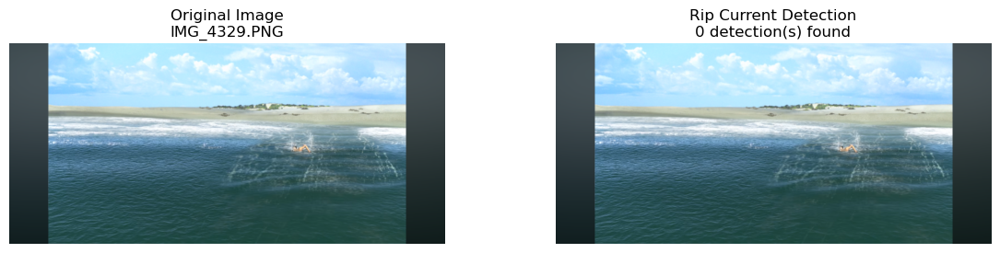


💡 USAGE INSTRUCTIONS:
To test a different image:
   1. Change IMAGE_PATH = r"your_image_path_here"
To adjust sensitivity:
   2. Change CONFIDENCE_THRESHOLD (current: 0.15)
      - Higher values (0.5-0.9): More strict, fewer false positives
      - Lower values (0.1-0.4): More sensitive, may include uncertain detections
To adjust display size:
   3. Change DISPLAY_WIDTH (current: 12)


In [ ]:
# 🎯 Individual Rip Current Image Testing
print("🎯 INDIVIDUAL RIP CURRENT IMAGE TESTING")
print("=" * 50)

import os
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw, ImageFont
import torch
from ultralytics import YOLO

# =============================================================================
# 📝 CONFIGURATION - MODIFY THESE VALUES
# =============================================================================

# 🖼️ IMAGE PATH - Change this to test different images
IMAGE_PATH = r"A:\5_projects\rip_current_project\test_images\real_time\IMG_4329.PNG"

# 🎚️ CONFIDENCE THRESHOLD - Adjust this value (0.0 to 1.0)
CONFIDENCE_THRESHOLD = 0.15  # Only show detections above this confidence

# 📏 IMAGE DISPLAY SIZE - Adjust for better viewing
DISPLAY_WIDTH = 12  # Width in inches for matplotlib display

# =============================================================================

# Set model path
RIP_MODEL_PATH = r"A:\5_projects\rip_current_project\rip_detector_best.pt"

print(f"📍 Model path: {RIP_MODEL_PATH}")
print(f"🖼️ Image path: {IMAGE_PATH}")
print(f"🎚️ Confidence threshold: {CONFIDENCE_THRESHOLD}")
print(f"📏 Display width: {DISPLAY_WIDTH} inches")

# Check if model exists
if not os.path.exists(RIP_MODEL_PATH):
    print(f"❌ Model not found: {RIP_MODEL_PATH}")
    print("   Please make sure the rip detector training completed successfully")
elif not os.path.exists(IMAGE_PATH):
    print(f"❌ Image not found: {IMAGE_PATH}")
    print("   Please check the image path and make sure the file exists")
    print("   💡 Tip: Update the IMAGE_PATH variable above with your desired image")
else:
    print(f"✅ Model found: {RIP_MODEL_PATH}")
    print(f"✅ Image found: {IMAGE_PATH}")
    
    try:
        print("\n🤖 Loading rip current detector model...")
        model = YOLO(RIP_MODEL_PATH)
        print("✅ Model loaded successfully")
        
        # Get class names
        class_names = model.names if hasattr(model, 'names') else {0: 'rip'}
        print(f"📋 Model classes: {class_names}")
        
        print(f"\n🔍 Running inference on image...")
        print(f"   Using confidence threshold: {CONFIDENCE_THRESHOLD}")
        
        # Run inference
        results = model(IMAGE_PATH, verbose=False, conf=CONFIDENCE_THRESHOLD)
        result = results[0]
        
        # Load original image
        img = Image.open(IMAGE_PATH)
        img_width, img_height = img.size
        print(f"📐 Image dimensions: {img_width} x {img_height} pixels")
        
        # Create a copy for drawing
        img_draw = img.copy()
        draw = ImageDraw.Draw(img_draw)
        
        # Try to use a better font
        try:
            font = ImageFont.truetype("arial.ttf", size=max(12, min(img_width, img_height) // 50))
        except:
            font = ImageFont.load_default()
        
        # Process detections
        detections = []
        detection_count = 0
        
        if hasattr(result, 'boxes') and result.boxes is not None and len(result.boxes) > 0:
            boxes = result.boxes
            detection_count = len(boxes)
            
            print(f"🌊 Found {detection_count} rip current detection(s) above threshold!")
            print("=" * 40)
            
            for i, box in enumerate(boxes):
                # Get box coordinates
                x1, y1, x2, y2 = box.xyxy[0].tolist()
                confidence = float(box.conf[0])
                class_id = int(box.cls[0])
                class_name = class_names.get(class_id, f"class_{class_id}")
                
                # Store detection info
                detection_info = {
                    'id': i + 1,
                    'bbox': (x1, y1, x2, y2),
                    'confidence': confidence,
                    'class': class_name,
                    'center': ((x1 + x2) / 2, (y1 + y2) / 2),
                    'area': (x2 - x1) * (y2 - y1)
                }
                detections.append(detection_info)
                
                # Choose color based on confidence
                if confidence > 0.7:
                    box_color = 'red'
                    text_color = 'red'
                elif confidence > 0.5:
                    box_color = 'orange'
                    text_color = 'orange'
                else:
                    box_color = 'yellow'
                    text_color = 'yellow'
                
                # Draw bounding box
                line_width = max(2, min(img_width, img_height) // 200)
                draw.rectangle([x1, y1, x2, y2], outline=box_color, width=line_width)
                
                # Draw label with background
                label = f"#{i+1}: {class_name} {confidence:.3f}"
                
                # Get text size for background
                bbox = draw.textbbox((0, 0), label, font=font)
                text_width = bbox[2] - bbox[0]
                text_height = bbox[3] - bbox[1]
                
                # Draw text background
                text_bg_coords = [x1, y1 - text_height - 4, x1 + text_width + 4, y1]
                draw.rectangle(text_bg_coords, fill=box_color)
                
                # Draw text
                draw.text((x1 + 2, y1 - text_height - 2), label, fill='white', font=font)
                
                # Print detection details
                print(f"Detection #{i+1}:")
                print(f"  📊 Class: {class_name}")
                print(f"  🎯 Confidence: {confidence:.4f}")
                print(f"  📍 Bounding Box: ({x1:.1f}, {y1:.1f}) to ({x2:.1f}, {y2:.1f})")
                print(f"  📐 Size: {x2-x1:.1f} x {y2-y1:.1f} pixels")
                print(f"  🎯 Center: ({(x1+x2)/2:.1f}, {(y1+y2)/2:.1f})")
                print(f"  📏 Area: {(x2-x1)*(y2-y1):.0f} pixels²")
                print()
        
        else:
            print(f"✅ No rip currents detected above confidence threshold {CONFIDENCE_THRESHOLD}")
            print("💡 Try lowering the confidence threshold if you expect detections")
        
        # Display results
        print("=" * 50)
        print("📊 DETECTION SUMMARY:")
        print(f"   Image: {os.path.basename(IMAGE_PATH)}")
        print(f"   Confidence Threshold: {CONFIDENCE_THRESHOLD}")
        print(f"   Detections Found: {detection_count}")
        
        if detections:
            confidences = [d['confidence'] for d in detections]
            areas = [d['area'] for d in detections]
            
            print(f"   Highest Confidence: {max(confidences):.4f}")
            print(f"   Lowest Confidence: {min(confidences):.4f}")
            print(f"   Average Confidence: {sum(confidences)/len(confidences):.4f}")
            print(f"   Largest Detection: {max(areas):.0f} pixels²")
            print(f"   Smallest Detection: {min(areas):.0f} pixels²")
        
        # Create display
        fig, axes = plt.subplots(1, 2, figsize=(DISPLAY_WIDTH, DISPLAY_WIDTH * img_height / img_width / 2))
        
        # Original image
        axes[0].imshow(img)
        axes[0].set_title(f"Original Image\n{os.path.basename(IMAGE_PATH)}", fontsize=12)
        axes[0].axis('off')
        
        # Image with detections
        axes[1].imshow(img_draw)
        title = f"Rip Current Detection\n{detection_count} detection(s) found"
        if detection_count > 0:
            title += f"\nThreshold: {CONFIDENCE_THRESHOLD}"
        axes[1].set_title(title, fontsize=12)
        axes[1].axis('off')
        
        plt.tight_layout()
        plt.show()
        
        # Usage instructions
        print("\n" + "=" * 50)
        print("💡 USAGE INSTRUCTIONS:")
        print("To test a different image:")
        print(f'   1. Change IMAGE_PATH = r"your_image_path_here"')
        print("To adjust sensitivity:")
        print(f"   2. Change CONFIDENCE_THRESHOLD (current: {CONFIDENCE_THRESHOLD})")
        print("      - Higher values (0.5-0.9): More strict, fewer false positives")
        print("      - Lower values (0.1-0.4): More sensitive, may include uncertain detections")
        print("To adjust display size:")
        print(f"   3. Change DISPLAY_WIDTH (current: {DISPLAY_WIDTH})")
        
        if detection_count > 0:
            print("\n🌊 DETECTION LEGEND:")
            print("   🔴 Red boxes: High confidence (>0.7)")
            print("   🟠 Orange boxes: Medium confidence (0.5-0.7)")
            print("   🟡 Yellow boxes: Lower confidence (<0.5)")
        
    except Exception as e:
        print(f"❌ Error during inference: {str(e)}")
        print("   Please check that the model and image are valid")

print("=" * 50)

🔄 COMPLETE PIPELINE: BEACH CLASSIFICATION + RIP DETECTION
Processing images through both models sequentially:
1️⃣ Beach Classifier: Determines if image contains a beach
2️⃣ Rip Detector: If beach detected, looks for rip currents
📁 Test Images Directory: A:\5_projects\rip_current_project\test_images\rip
🏖️ Beach Model: A:\5_projects\rip_current_project\beach_classifier_best.pt
🌊 Rip Model: A:\5_projects\rip_current_project\rip_detector_best.pt
🎚️ Beach Threshold: 0.5
🎚️ Rip Threshold: 0.3
✅ All paths verified

🤖 Loading models...
✅ Beach classifier loaded
✅ Rip detector loaded
🏖️ Beach classes: {0: 'beach', 1: 'not beach'}
🌊 Rip classes: {0: 'rip'}

📸 Found 29 test images

🔄 Processing images through pipeline...
----------------------------------------
Processing 1/29: 240624-rip-current-vl-211p-b26302.jpg
  🏖️ Beach: beach (1.000)
  🌊 Rip: 1 detection(s), max confidence: 0.608
Processing 2/29: 6BD40F03-7CDE-4FE2-B862B3D51552D774_source (1).webp
  🏖️ Beach: beach (0.964)
  🌊 Rip: 1 dete

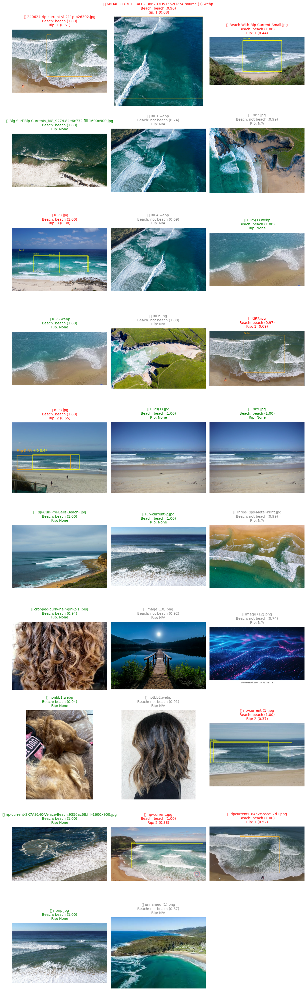


📊 PIPELINE SUMMARY STATISTICS
📸 Total Images Processed: 29
🏖️ Beach Detected: 20 (69.0%)
🏞️ No Beach: 9 (31.0%)
🌊 Rip Currents Detected: 9 (31.0%)
✅ Beach without Rip: 11 (37.9%)
📈 Rip Detection Rate in Beaches: 45.0%
🎯 Beach Confidence - Avg: 0.954, Min: 0.688, Max: 1.000
🌊 Rip Confidence - Avg: 0.464, Min: 0.320, Max: 0.687
📊 Total Rip Detections: 14

🔍 LEGEND:
🚨 Red titles: Rip currents detected
✅ Green titles: Beach without rip currents
🏞️ Gray titles: No beach detected
🔴 Red boxes: High confidence rip (>0.7)
🟠 Orange boxes: Medium confidence rip (0.5-0.7)
🟡 Yellow boxes: Lower confidence rip (<0.5)

💡 PIPELINE WORKFLOW:
1. Each image is first classified as 'beach' or 'not beach'
2. If classified as 'beach', it's processed by the rip detector
3. If not a beach, rip detection is skipped (saves computation)
4. Results show both beach classification and rip detection outcomes


In [ ]:
# 🔄 Complete Pipeline: Beach Classification + Rip Detection
print("🔄 COMPLETE PIPELINE: BEACH CLASSIFICATION + RIP DETECTION")
print("=" * 60)
print("Processing images through both models sequentially:")
print("1️⃣ Beach Classifier: Determines if image contains a beach")
print("2️⃣ Rip Detector: If beach detected, looks for rip currents")
print("=" * 60)

import os
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw, ImageFont
import torch
from ultralytics import YOLO
import math

# Configuration
TEST_IMAGES_DIR = r"A:\5_projects\rip_current_project\test_images\rip"
BEACH_MODEL_PATH = r"A:\5_projects\rip_current_project\beach_classifier_best.pt"
RIP_MODEL_PATH = r"A:\5_projects\rip_current_project\rip_detector_best.pt"

# Thresholds
BEACH_CONFIDENCE_THRESHOLD = 0.5  # Threshold for beach classification
RIP_CONFIDENCE_THRESHOLD = 0.3    # Threshold for rip detection

# Display settings
IMAGES_PER_ROW = 3
IMAGE_SIZE = 4  # Size of each subplot in inches

print(f"📁 Test Images Directory: {TEST_IMAGES_DIR}")
print(f"🏖️ Beach Model: {BEACH_MODEL_PATH}")
print(f"🌊 Rip Model: {RIP_MODEL_PATH}")
print(f"🎚️ Beach Threshold: {BEACH_CONFIDENCE_THRESHOLD}")
print(f"🎚️ Rip Threshold: {RIP_CONFIDENCE_THRESHOLD}")

# Check if paths exist
if not os.path.exists(TEST_IMAGES_DIR):
    print(f"❌ Test images directory not found: {TEST_IMAGES_DIR}")
elif not os.path.exists(BEACH_MODEL_PATH):
    print(f"❌ Beach model not found: {BEACH_MODEL_PATH}")
elif not os.path.exists(RIP_MODEL_PATH):
    print(f"❌ Rip model not found: {RIP_MODEL_PATH}")
else:
    print("✅ All paths verified")
    
    try:
        # Load models
        print("\n🤖 Loading models...")
        beach_model = YOLO(BEACH_MODEL_PATH)
        rip_model = YOLO(RIP_MODEL_PATH)
        print("✅ Beach classifier loaded")
        print("✅ Rip detector loaded")
        
        # Get model class names
        beach_classes = beach_model.names if hasattr(beach_model, 'names') else {0: 'not beach', 1: 'beach'}
        rip_classes = rip_model.names if hasattr(rip_model, 'names') else {0: 'rip'}
        
        print(f"🏖️ Beach classes: {beach_classes}")
        print(f"🌊 Rip classes: {rip_classes}")
        
        # Get test images
        image_extensions = ['.jpg', '.jpeg', '.png', '.bmp', '.tiff', '.webp']
        test_images = []
        
        if os.path.exists(TEST_IMAGES_DIR):
            for img_name in os.listdir(TEST_IMAGES_DIR):
                img_name_lower = img_name.lower()
                if any(img_name_lower.endswith(ext) for ext in image_extensions):
                    img_path = os.path.join(TEST_IMAGES_DIR, img_name)
                    test_images.append(img_path)
        
        test_images.sort()  # Sort for consistent ordering
        
        print(f"\n📸 Found {len(test_images)} test images")
        
        if len(test_images) == 0:
            print("❌ No valid images found in test directory")
        else:
            # Process images through pipeline
            pipeline_results = []
            
            print("\n🔄 Processing images through pipeline...")
            print("-" * 40)
            
            for i, img_path in enumerate(test_images, 1):
                img_name = os.path.basename(img_path)
                print(f"Processing {i}/{len(test_images)}: {img_name}")
                
                try:
                    # Load image
                    img = Image.open(img_path)
                    
                    # Stage 1: Beach Classification
                    beach_results = beach_model(img_path, verbose=False)
                    beach_result = beach_results[0]
                    
                    # Get beach prediction
                    beach_probs = beach_result.probs.data.tolist()
                    beach_top1_idx = beach_result.probs.top1
                    beach_confidence = beach_probs[beach_top1_idx]
                    beach_prediction = beach_classes.get(beach_top1_idx, f"class_{beach_top1_idx}")
                    
                    is_beach = beach_prediction.lower() == 'beach' and beach_confidence >= BEACH_CONFIDENCE_THRESHOLD
                    
                    # Initialize result dictionary
                    result = {
                        'image_path': img_path,
                        'image_name': img_name,
                        'image': img,
                        'beach_prediction': beach_prediction,
                        'beach_confidence': beach_confidence,
                        'is_beach': is_beach,
                        'rip_detections': [],
                        'rip_count': 0,
                        'has_rip': False,
                        'max_rip_confidence': 0.0,
                        'pipeline_status': 'beach_only'
                    }
                    
                    print(f"  🏖️ Beach: {beach_prediction} ({beach_confidence:.3f})")
                    
                    # Stage 2: Rip Detection (only if beach detected)
                    if is_beach:
                        rip_results = rip_model(img_path, verbose=False, conf=RIP_CONFIDENCE_THRESHOLD)
                        rip_result = rip_results[0]
                        
                        if hasattr(rip_result, 'boxes') and rip_result.boxes is not None and len(rip_result.boxes) > 0:
                            boxes = rip_result.boxes
                            rip_detections = []
                            
                            for box in boxes:
                                x1, y1, x2, y2 = box.xyxy[0].tolist()
                                rip_confidence = float(box.conf[0])
                                class_id = int(box.cls[0])
                                class_name = rip_classes.get(class_id, f"class_{class_id}")
                                
                                rip_detections.append({
                                    'bbox': (x1, y1, x2, y2),
                                    'confidence': rip_confidence,
                                    'class': class_name
                                })
                            
                            result['rip_detections'] = rip_detections
                            result['rip_count'] = len(rip_detections)
                            result['has_rip'] = True
                            result['max_rip_confidence'] = max([d['confidence'] for d in rip_detections])
                            result['pipeline_status'] = 'rip_detected'
                            
                            print(f"  🌊 Rip: {len(rip_detections)} detection(s), max confidence: {result['max_rip_confidence']:.3f}")
                        else:
                            result['pipeline_status'] = 'no_rip'
                            print(f"  🌊 Rip: No detections above threshold")
                    else:
                        print(f"  🌊 Rip: Skipped (not a beach)")
                    
                    pipeline_results.append(result)
                    
                except Exception as e:
                    print(f"  ❌ Error processing {img_name}: {str(e)}")
                    continue
            
            print("-" * 40)
            print("✅ Pipeline processing complete")
            
            # Create visualizations
            if pipeline_results:
                # Calculate grid dimensions
                num_images = len(pipeline_results)
                rows = math.ceil(num_images / IMAGES_PER_ROW)
                
                # Create figure
                fig_width = IMAGES_PER_ROW * IMAGE_SIZE
                fig_height = rows * IMAGE_SIZE
                fig, axes = plt.subplots(rows, IMAGES_PER_ROW, figsize=(fig_width, fig_height))
                
                # Handle single row case
                if rows == 1:
                    axes = [axes] if num_images == 1 else axes
                else:
                    axes = axes.flatten()
                
                print(f"\n📊 Displaying {num_images} processed images...")
                
                for idx, result in enumerate(pipeline_results):
                    ax = axes[idx] if num_images > 1 else axes
                    
                    # Prepare image for display
                    display_img = result['image'].copy()
                    
                    # Draw rip detections if any
                    if result['rip_detections']:
                        draw = ImageDraw.Draw(display_img)
                        
                        # Try to use a better font
                        try:
                            font_size = max(12, min(display_img.size) // 50)
                            font = ImageFont.truetype("arial.ttf", size=font_size)
                        except:
                            font = ImageFont.load_default()
                        
                        for i, detection in enumerate(result['rip_detections']):
                            x1, y1, x2, y2 = detection['bbox']
                            confidence = detection['confidence']
                            
                            # Color coding based on confidence
                            if confidence > 0.7:
                                color = 'red'
                            elif confidence > 0.5:
                                color = 'orange'
                            else:
                                color = 'yellow'
                            
                            # Draw bounding box
                            line_width = max(2, min(display_img.size) // 200)
                            draw.rectangle([x1, y1, x2, y2], outline=color, width=line_width)
                            
                            # Draw label
                            label = f"Rip {confidence:.2f}"
                            draw.text((x1, y1-20), label, fill=color, font=font)
                    
                    # Display image
                    ax.imshow(display_img)
                    ax.axis('off')
                    
                    # Create title with pipeline results
                    img_name = result['image_name']
                    beach_pred = result['beach_prediction']
                    beach_conf = result['beach_confidence']
                    
                    if result['has_rip']:
                        rip_info = f"Rip: {result['rip_count']} ({result['max_rip_confidence']:.2f})"
                        title_color = 'red'
                        status_emoji = "🚨"
                    elif result['is_beach'] and not result['has_rip']:
                        rip_info = "Rip: None"
                        title_color = 'green'
                        status_emoji = "✅"
                    else:
                        rip_info = "Rip: N/A"
                        title_color = 'gray'
                        status_emoji = "🏞️"
                    
                    title = f"{status_emoji} {img_name}\nBeach: {beach_pred} ({beach_conf:.2f})\n{rip_info}"
                    ax.set_title(title, fontsize=10, color=title_color, pad=10)
                
                # Hide unused subplots
                for idx in range(num_images, len(axes)):
                    axes[idx].axis('off')
                
                plt.tight_layout()
                plt.show()
                
                # Print summary statistics
                print("\n" + "=" * 60)
                print("📊 PIPELINE SUMMARY STATISTICS")
                print("=" * 60)
                
                total_images = len(pipeline_results)
                beach_detected = sum(1 for r in pipeline_results if r['is_beach'])
                rip_detected = sum(1 for r in pipeline_results if r['has_rip'])
                no_beach = total_images - beach_detected
                beach_no_rip = beach_detected - rip_detected
                
                print(f"📸 Total Images Processed: {total_images}")
                print(f"🏖️ Beach Detected: {beach_detected} ({beach_detected/total_images*100:.1f}%)")
                print(f"🏞️ No Beach: {no_beach} ({no_beach/total_images*100:.1f}%)")
                print(f"🌊 Rip Currents Detected: {rip_detected} ({rip_detected/total_images*100:.1f}%)")
                print(f"✅ Beach without Rip: {beach_no_rip} ({beach_no_rip/total_images*100:.1f}%)")
                
                if beach_detected > 0:
                    rip_rate_in_beaches = rip_detected / beach_detected * 100
                    print(f"📈 Rip Detection Rate in Beaches: {rip_rate_in_beaches:.1f}%")
                
                # Beach confidence stats
                beach_confidences = [r['beach_confidence'] for r in pipeline_results]
                print(f"🎯 Beach Confidence - Avg: {sum(beach_confidences)/len(beach_confidences):.3f}, "
                      f"Min: {min(beach_confidences):.3f}, Max: {max(beach_confidences):.3f}")
                
                # Rip confidence stats
                rip_confidences = []
                total_rip_detections = 0
                for r in pipeline_results:
                    for detection in r['rip_detections']:
                        rip_confidences.append(detection['confidence'])
                        total_rip_detections += 1
                
                if rip_confidences:
                    print(f"🌊 Rip Confidence - Avg: {sum(rip_confidences)/len(rip_confidences):.3f}, "
                          f"Min: {min(rip_confidences):.3f}, Max: {max(rip_confidences):.3f}")
                    print(f"📊 Total Rip Detections: {total_rip_detections}")
                
                print("\n🔍 LEGEND:")
                print("🚨 Red titles: Rip currents detected")
                print("✅ Green titles: Beach without rip currents")
                print("🏞️ Gray titles: No beach detected")
                print("🔴 Red boxes: High confidence rip (>0.7)")
                print("🟠 Orange boxes: Medium confidence rip (0.5-0.7)")
                print("🟡 Yellow boxes: Lower confidence rip (<0.5)")
                
                print("\n💡 PIPELINE WORKFLOW:")
                print("1. Each image is first classified as 'beach' or 'not beach'")
                print("2. If classified as 'beach', it's processed by the rip detector")
                print("3. If not a beach, rip detection is skipped (saves computation)")
                print("4. Results show both beach classification and rip detection outcomes")
                
            else:
                print("❌ No images were successfully processed")
        
    except Exception as e:
        print(f"❌ Error in pipeline: {str(e)}")

print("=" * 60)


✅ Video processing completed!
📊 Detection Statistics:
   - Total frames processed: 1400
   - Frames with rip currents: 8
   - Total rip current detections: 8
   - Average detections per frame: 0.01
📁 Annotated video saved to: A:/5_projects/rip_current_project/output_rip_detection_video.mp4

📊 Analyzing detection results...


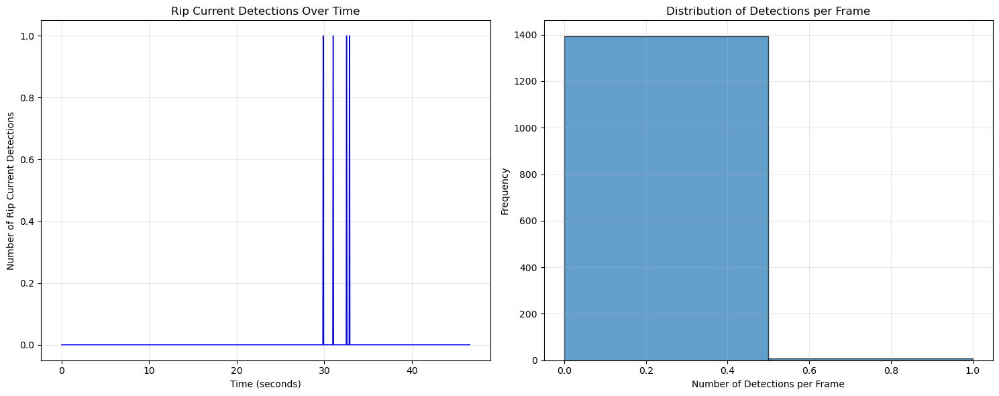


📈 Detailed Analysis:
   - Video duration: 46.67 seconds
   - Detection rate: 0.6% of frames
   - Peak detections in single frame: 1
   - Average detections per second: 0.17


In [ ]:
# Real-time Rip Current Detection in Video
import cv2
import torch
import numpy as np
from ultralytics import YOLO
import matplotlib.pyplot as plt
from IPython.display import clear_output, display, HTML
import time
import os

# Load the trained rip detector model
rip_model_path = "A:/5_projects/rip_current_project/rip_detector_best.pt"
rip_model = YOLO(rip_model_path)

print(f"✅ Loaded rip detector model from: {rip_model_path}")

# Video path
video_path = "A:/5_projects/rip_current_project/test_images/videos/Rip Current Safety Animation - National Weather Service (NWS) (1080p, h264).mp4"

# Check if video exists
if not os.path.exists(video_path):
    print(f"❌ Video file not found: {video_path}")
else:
    print(f"✅ Video file found: {video_path}")

def process_video_realtime(video_path, model, confidence_threshold=0.3, save_output=True):
    """
    Process video for real-time rip current detection
    """
    # Open video capture
    cap = cv2.VideoCapture(video_path)
    
    if not cap.isOpened():
        print("❌ Error: Could not open video file")
        return
    
    # Get video properties
    fps = int(cap.get(cv2.CAP_PROP_FPS))
    width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
    height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
    total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
    
    print(f"📹 Video Properties:")
    print(f"   - Resolution: {width}x{height}")
    print(f"   - FPS: {fps}")
    print(f"   - Total Frames: {total_frames}")
    print(f"   - Duration: {total_frames/fps:.2f} seconds")
    
    # Prepare output video writer if saving
    if save_output:
        output_path = "A:/5_projects/rip_current_project/output_rip_detection_video.mp4"
        fourcc = cv2.VideoWriter_fourcc(*'mp4v')
        out = cv2.VideoWriter(output_path, fourcc, fps, (width, height))
        print(f"📁 Output will be saved to: {output_path}")
    
    frame_count = 0
    detections_per_frame = []
    
    print("\n🎬 Starting real-time rip current detection...")
    print("Processing frames:")
    
    try:
        while True:
            ret, frame = cap.read()
            if not ret:
                break
            
            frame_count += 1
            
            # Run YOLO detection on the frame
            results = model(frame, conf=confidence_threshold, verbose=False)
            
            # Process detections
            detections_count = 0
            annotated_frame = frame.copy()
            
            for result in results:
                boxes = result.boxes
                if boxes is not None:
                    for box in boxes:
                        # Get bounding box coordinates
                        x1, y1, x2, y2 = box.xyxy[0].cpu().numpy().astype(int)
                        confidence = box.conf[0].cpu().numpy()
                        class_id = int(box.cls[0].cpu().numpy())
                        
                        # Draw bounding box
                        cv2.rectangle(annotated_frame, (x1, y1), (x2, y2), (0, 0, 255), 3)
                        
                        # Add label with confidence
                        label = f"Rip Current: {confidence:.2f}"
                        label_size = cv2.getTextSize(label, cv2.FONT_HERSHEY_SIMPLEX, 0.7, 2)[0]
                        
                        # Background for text
                        cv2.rectangle(annotated_frame, 
                                    (x1, y1 - label_size[1] - 10), 
                                    (x1 + label_size[0], y1), 
                                    (0, 0, 255), -1)
                        
                        # Text
                        cv2.putText(annotated_frame, label, 
                                  (x1, y1 - 5), 
                                  cv2.FONT_HERSHEY_SIMPLEX, 0.7, 
                                  (255, 255, 255), 2)
                        
                        detections_count += 1
            
            # Add frame information
            info_text = f"Frame: {frame_count}/{total_frames} | Rip Currents Detected: {detections_count}"
            cv2.putText(annotated_frame, info_text, (10, 30), 
                       cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2)
            
            # Add timestamp
            timestamp = f"Time: {frame_count/fps:.2f}s"
            cv2.putText(annotated_frame, timestamp, (10, 70), 
                       cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2)
            
            detections_per_frame.append(detections_count)
            
            # Save frame if output video is being created
            if save_output:
                out.write(annotated_frame)
            
            # Display progress every 30 frames (approximately every second for 30fps video)
            if frame_count % 30 == 0:
                progress = (frame_count / total_frames) * 100
                print(f"   Frame {frame_count}/{total_frames} ({progress:.1f}%) - Detections: {detections_count}")
                
                # Convert BGR to RGB for matplotlib
                display_frame = cv2.cvtColor(annotated_frame, cv2.COLOR_BGR2RGB)
                
                # Display current frame
                plt.figure(figsize=(12, 8))
                plt.imshow(display_frame)
                plt.title(f"Real-time Rip Current Detection - Frame {frame_count}")
                plt.axis('off')
                plt.tight_layout()
                plt.show()
                
                clear_output(wait=True)
    
    except KeyboardInterrupt:
        print("\n⏹️ Processing interrupted by user")
    
    finally:
        # Release resources
        cap.release()
        if save_output:
            out.release()
        
        print(f"\n✅ Video processing completed!")
        print(f"📊 Detection Statistics:")
        print(f"   - Total frames processed: {frame_count}")
        print(f"   - Frames with rip currents: {sum(1 for x in detections_per_frame if x > 0)}")
        print(f"   - Total rip current detections: {sum(detections_per_frame)}")
        print(f"   - Average detections per frame: {np.mean(detections_per_frame):.2f}")
        
        if save_output:
            print(f"📁 Annotated video saved to: {output_path}")
    
    return detections_per_frame

def analyze_video_detections(detections_per_frame, fps):
    """
    Analyze and visualize detection results over time
    """
    time_points = [i/fps for i in range(len(detections_per_frame))]
    
    plt.figure(figsize=(15, 6))
    
    # Plot detections over time
    plt.subplot(1, 2, 1)
    plt.plot(time_points, detections_per_frame, 'b-', linewidth=1)
    plt.fill_between(time_points, detections_per_frame, alpha=0.3)
    plt.xlabel('Time (seconds)')
    plt.ylabel('Number of Rip Current Detections')
    plt.title('Rip Current Detections Over Time')
    plt.grid(True, alpha=0.3)
    
    # Detection histogram
    plt.subplot(1, 2, 2)
    plt.hist(detections_per_frame, bins=max(1, max(detections_per_frame)+1), 
             edgecolor='black', alpha=0.7)
    plt.xlabel('Number of Detections per Frame')
    plt.ylabel('Frequency')
    plt.title('Distribution of Detections per Frame')
    plt.grid(True, alpha=0.3)
    
    plt.tight_layout()
    plt.show()
    
    # Summary statistics
    total_detections = sum(detections_per_frame)
    frames_with_detections = sum(1 for x in detections_per_frame if x > 0)
    detection_rate = frames_with_detections / len(detections_per_frame) * 100
    
    print(f"\n📈 Detailed Analysis:")
    print(f"   - Video duration: {len(detections_per_frame)/fps:.2f} seconds")
    print(f"   - Detection rate: {detection_rate:.1f}% of frames")
    print(f"   - Peak detections in single frame: {max(detections_per_frame)}")
    print(f"   - Average detections per second: {total_detections/(len(detections_per_frame)/fps):.2f}")

# Run the real-time video processing
print("🚀 Starting real-time rip current detection in video...")
print("This will process the video frame by frame and identify rip currents with bounding boxes.")
print("\nPress Ctrl+C if you want to stop processing early.\n")

# Process the video
detections = process_video_realtime(video_path, rip_model, confidence_threshold=0.4)

# Analyze results
if detections:
    print("\n📊 Analyzing detection results...")
    analyze_video_detections(detections, 30)  # Assuming 30 FPS, adjust if needed